# Clustering of all gastruloid data

In [13]:
%matplotlib inline
import numpy as np
import pandas as pd
import scanpy as sc
from functools import reduce
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
from anndata import AnnData, read_h5ad
import singlecellmultiomics.bamProcessing.bamToRNACounts
import collections

In [14]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()

dpi = 50
sc.set_figure_params(dpi=dpi, color_map = 'viridis')

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.20.3 scipy==1.7.3 pandas==1.4.1 scikit-learn==0.23.2 statsmodels==0.12.2 pynndescent==0.5.6


# Load the dataset

In [3]:
pathToData = '/Users/m.blotenburg/Documents/Projects/Mouse_Scartrace/Data_analysis/Transcriptome_analysis/120hAA/20200928_FACS5_scGastruloid_VAN5044/'

In [4]:
df120 = pd.read_pickle(pathToData + 'dataframes/20200928_transcriptome_FACS5_VAN5044.pickle.gz')

In [5]:
results_file = pathToData + '/write/FACS5_dataset120hAA.h5ad'  # the file that will store the analysis results

In [6]:
df120.head()

,A1_1.1,A1_10.1,A1_100.1,A1_101.1,A1_102.1,A1_103.1,A1_104.1,A1_105.1,A1_106.1,A1_107.1,...,A2_90.4,A2_91.4,A2_92.4,A2_93.4,A2_94.4,A2_95.4,A2_96.4,A2_97.4,A2_98.4,A2_99.4
ENSMUSG00000033813_1,NaN,NaN,1.0,1.0,1.0,NaN,1.0,NaN,NaN,1.0,...,NaN,NaN,NaN,NaN,NaN,1.0,NaN,1.0,1.0,NaN
ENSMUSG00000061024_1,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ENSMUSG00000098234_1,NaN,NaN,3.0,1.0,1.0,NaN,NaN,NaN,1.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ENSMUSG00000025917_1,1.0,NaN,1.0,1.0,2.0,1.0,1.0,NaN,1.0,1.0,...,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,3.0,NaN
ENSMUSG00000016918_1,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.0,NaN,NaN,NaN,2.0,NaN,NaN


In [7]:
df120 = df120.fillna(0)

In [8]:
print('Dataset 120hAA')
print(df120.shape)

Dataset 120hAA
(31788, 4597)


In [9]:
df120 = df120.loc[df120.index.dropna()]

In [10]:
df120 = df120.astype(float)

In [11]:
adata_120 = sc.AnnData(df120.transpose())

In [12]:
adata=adata_120

# Preprocessing of dataset 1 - 120h AA

make gene names more workable

In [15]:
adata.var.index = adata.var.index.str.split('_',0,expand=True)

In [16]:
adata.var.head()

,
ENSMUSG00000033813,1
ENSMUSG00000061024,1
ENSMUSG00000098234,1
ENSMUSG00000025917,1
ENSMUSG00000016918,1


In [17]:
index = adata.var.reset_index(level=(1))
index = index.rename(index=str, columns={"level_1": "chromosome"})
index.head()

,chromosome
ENSMUSG00000033813,1
ENSMUSG00000061024,1
ENSMUSG00000098234,1
ENSMUSG00000025917,1
ENSMUSG00000016918,1


In [18]:
index.index

Index(['ENSMUSG00000033813', 'ENSMUSG00000061024', 'ENSMUSG00000098234',
       'ENSMUSG00000025917', 'ENSMUSG00000016918', 'ENSMUSG00000082193',
       'ENSMUSG00000025925', 'ENSMUSG00000079658', 'ENSMUSG00000041859',
       'ENSMUSG00000100862',
       ...
       'ENSMUSG00000110049', 'ENSMUSG00000039981', 'ENSMUSG00000088378',
       'ENSMUSG00000107200', 'ENSMUSG00000087255', 'ENSMUSG00000078487',
       'ENSMUSG00000115059', 'ENSMUSG00000047841', 'ENSMUSG00000064971',
       'ENSMUSG00000041449'],
      dtype='object', length=31788)

In [19]:
index['ensembl'] = index.index

In [20]:
adata.var.index = index.index

In [21]:
adata.var['ensembl'] = index['ensembl']
adata.var['chromosome'] = index['chromosome']

In [22]:
conversion_table = singlecellmultiomics.bamProcessing.bamToRNACounts.get_gene_id_to_gene_name_conversion_table('/Users/m.blotenburg/Documents/Projects/Mouse_Scartrace/Data_analysis/RNAvelocity/exons.gtf.gz')


In [23]:
adata.var_names = np.array([conversion_table.get(x,x) for x in adata.var_names ])

In [24]:
adata.var_names_make_unique()

In [25]:
adata.var.head()

,ensembl,chromosome
Tcea1,ENSMUSG00000033813,1
Rrs1,ENSMUSG00000061024,1
Snhg6,ENSMUSG00000098234,1
Cops5,ENSMUSG00000025917,1
Sulf1,ENSMUSG00000016918,1


Show those genes that yield the highest fraction of counts in each single cells, across all cells.

normalizing counts per cell
    finished (0:00:00)


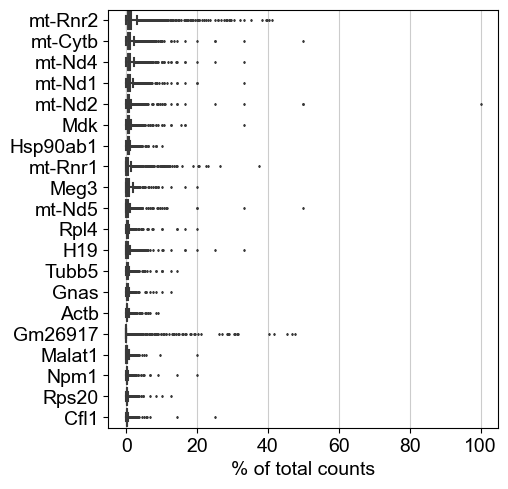

In [26]:
sc.pl.highest_expr_genes(adata, n_top=20)

Basic filtering.

In [27]:
adata

AnnData object with n_obs × n_vars = 4597 × 31788
    var: 'ensembl', 'chromosome'

In [31]:
adata.write("adata_20220127.h5ad")

/Users/m.blotenburg/miniconda3/envs/2022env/lib/python3.10/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'chromosome' as categorical


# To load adata file with corrected gene names and continue:

In [32]:
adata = sc.read("adata_20220127.h5ad")

In [28]:
adata

AnnData object with n_obs × n_vars = 4597 × 31788
    var: 'ensembl', 'chromosome'

In [29]:
minCount = 500
sc.pp.filter_cells(adata, min_counts=minCount)
sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=2)

filtered out 925 cells that have less than 500 counts
filtered out 5150 genes that are detected in less than 2 cells


Let us assemple some information about mitochondrial genes, which are important for quality control.

Citing from "Simple Single Cell" workflows [(Lun, McCarthy & Marioni, 2017)](https://master.bioconductor.org/packages/release/workflows/html/simpleSingleCell.html#examining-gene-level-metrics):

> High proportions are indicative of poor-quality cells (Islam et al. 2014; Ilicic et al. 2016), possibly because of loss of cytoplasmic RNA from perforated cells. The reasoning is that mitochondria are larger than individual transcript molecules and less likely to escape through tears in the cell membrane.

Note you can also use the function `pp.calculate_qc_metrics` to compute the fraction of mitochondrial genes and additional measures.

In [30]:
mito_genes = adata.var_names.str.startswith('mt-')

# for each cell compute fraction of counts in mito genes vs. all genes
adata.obs['percent_mito'] = np.sum(
    adata[:, mito_genes].X, axis=1) / np.sum(adata.X, axis=1)
# add the total counts per cell as observations-annotation to adata
adata.obs['n_counts'] = adata.X.sum(axis=1)

A violin plot of the computed quality measures.

/Users/m.blotenburg/miniconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'chromosome' as categorical


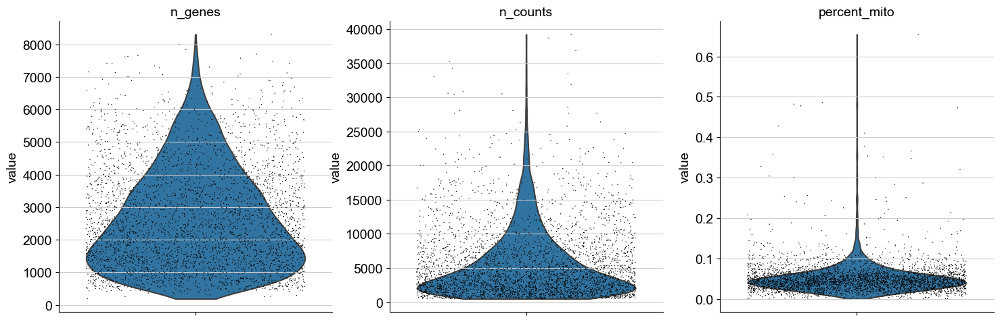

In [31]:
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],
             jitter=0.4, multi_panel=True)

Remove cells that have too many mitochondrial genes expressed or too many total counts.

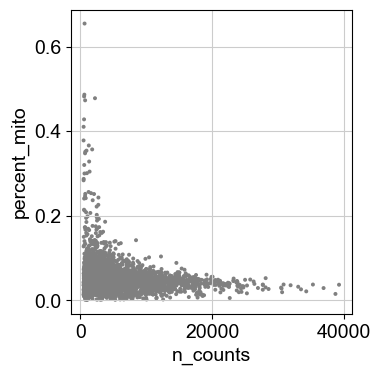

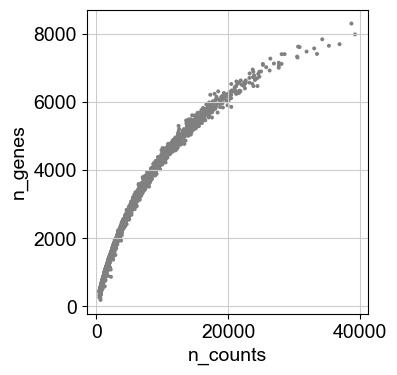

In [32]:
sc.pl.scatter(adata, x='n_counts', y='percent_mito')
sc.pl.scatter(adata, x='n_counts', y='n_genes')

In [33]:
adata

AnnData object with n_obs × n_vars = 3672 × 26638
    obs: 'n_counts', 'n_genes', 'percent_mito'
    var: 'ensembl', 'chromosome', 'n_cells'

Actually do the filtering.

In [34]:
adata = adata[adata.obs['percent_mito'] < 0.2, :]

throw out any other unwanted genes

In [35]:
# removing genes with annotations we are not interested in
banned = ['NA', 'mt-', "Malat1"]# 'Rpl', 'Rps']
keptGenes = [geneName for geneName in adata.var.index if not any( (b in geneName for b in banned) )]

adata = adata[:,keptGenes]

adata

View of AnnData object with n_obs × n_vars = 3636 × 26612
    obs: 'n_counts', 'n_genes', 'percent_mito'
    var: 'ensembl', 'chromosome', 'n_cells'

minCount = 1000
sc.pp.filter_cells(adata, min_counts=minCount)
sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=2)

Total-count normalize (library-size correct) the data matrix $\mathbf{X}$ to 10,000 reads per cell, so that counts become comparable among cells.

In [36]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=minCount)

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:02): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


Logarithmize the data.

In [37]:
sc.pp.log1p(adata)

Set the `.raw` attribute of AnnData object to the logarithmized raw gene expression for later use in differential testing and visualizations of gene expression. This simply freezes the state of the AnnData object. While many people consider the normalized data matrix as the "relevant data" for visualization and differential testing, some would prefer to store the unnormalized data.

In [38]:
adata.raw = adata

Identify highly-variable genes.

In [39]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


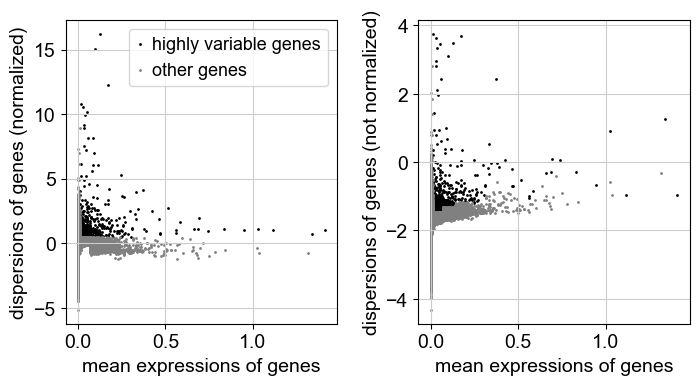

In [40]:
sc.pl.highly_variable_genes(adata)

Actually do the filtering.

In [41]:
#adata = adata[:, adata.var['highly_variable']]

Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.

In [42]:
sc.pp.regress_out(adata, ['n_counts', 'percent_mito'])

regressing out ['n_counts', 'percent_mito']
    finished (0:02:01)


Scale each gene to unit variance. Clip values exceeding standard deviation 10. 

In [43]:
sc.pp.scale(adata, max_value=10)

normalizing counts per cell


/Users/m.blotenburg/miniconda3/envs/scanpy2/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:182: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


    finished (0:00:01)


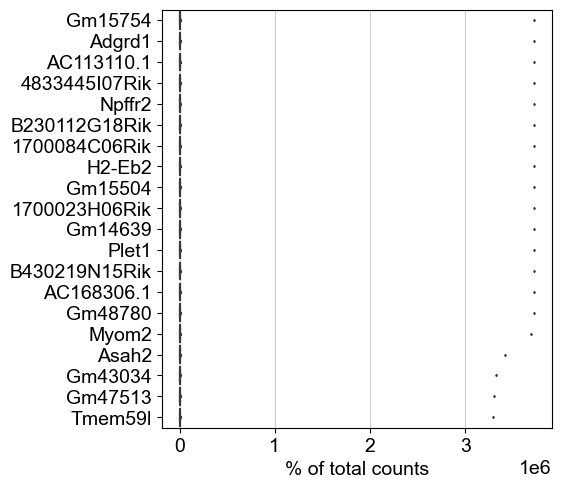

In [44]:
sc.pl.highest_expr_genes(adata, n_top=20)

In [45]:
adata

AnnData object with n_obs × n_vars = 3636 × 26612
    obs: 'n_counts', 'n_genes', 'percent_mito'
    var: 'ensembl', 'chromosome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'

## Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [46]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

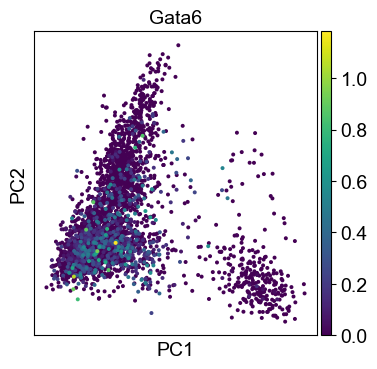

In [47]:
plotgene = [geneName for geneName in adata.var.index if any( (b in geneName for b in ['Gata6']) )]
sc.pl.pca(adata, color=plotgene)

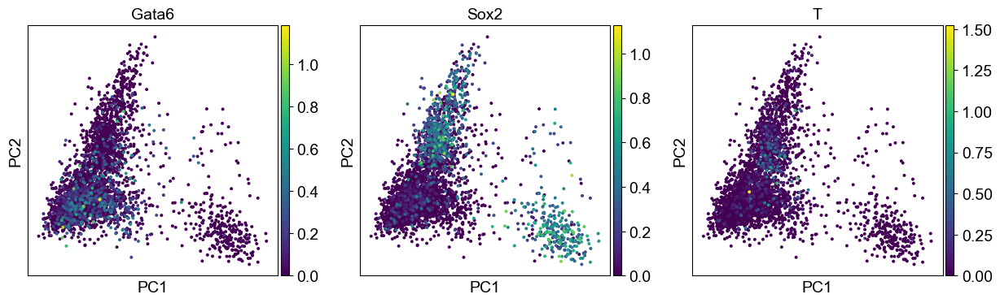

In [48]:
sc.pl.pca(adata, color=['Gata6','Sox2','T'])

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`. In our experience, often, a rough estimate of the number of PCs does fine.

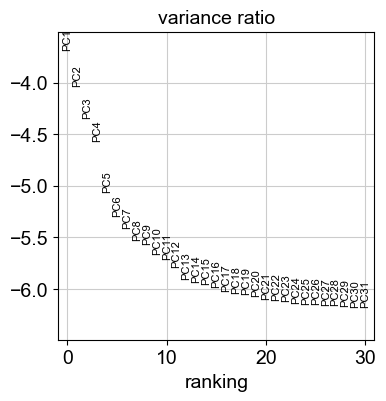

In [49]:
sc.pl.pca_variance_ratio(adata, log=True)

Save the result.

In [50]:
adata.write(results_file)

In [51]:
adata

AnnData object with n_obs × n_vars = 3636 × 26612
    obs: 'n_counts', 'n_genes', 'percent_mito'
    var: 'ensembl', 'chromosome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [52]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


## Embedding the neighborhood graph

We advertise embedding the graph in 2 dimensions using UMAP ([McInnes et al., 2018](https://arxiv.org/abs/1802.03426)), see below. It is  potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preservers trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

```
tl.paga(adata)
pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
tl.umap(adata, init_pos='paga')
```

In [53]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


In [54]:
batches = [ob.split('.')[1] for ob in adata.obs_names]
batches = [ob.split('_')[0] for ob in batches]

adata.obs['batch'] = batches

In [55]:
adata.obs

,n_counts,n_genes,percent_mito,batch
A1_1.1,2041.0,1443,0.068824,1
A1_10.1,2044.0,1472,0.085459,1
A1_100.1,3193.0,2125,0.054126,1
A1_101.1,4506.0,2720,0.043837,1
A1_102.1,2685.0,1862,0.064370,1
...,...,...,...,...
A2_95.4,2092.0,1081,0.045558,4
A2_96.4,572.0,387,0.098131,4
A2_97.4,2592.0,1781,0.101549,4
A2_98.4,5743.0,3194,0.021965,4


In [56]:
adata.obs['Gastruloid'] = adata.obs['batch'].str.replace('1','B11').str.replace('2','B08').str.replace('3','A08').str.replace('4','C01')

/Users/m.blotenburg/miniconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical
/Users/m.blotenburg/miniconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'Gastruloid' as categorical


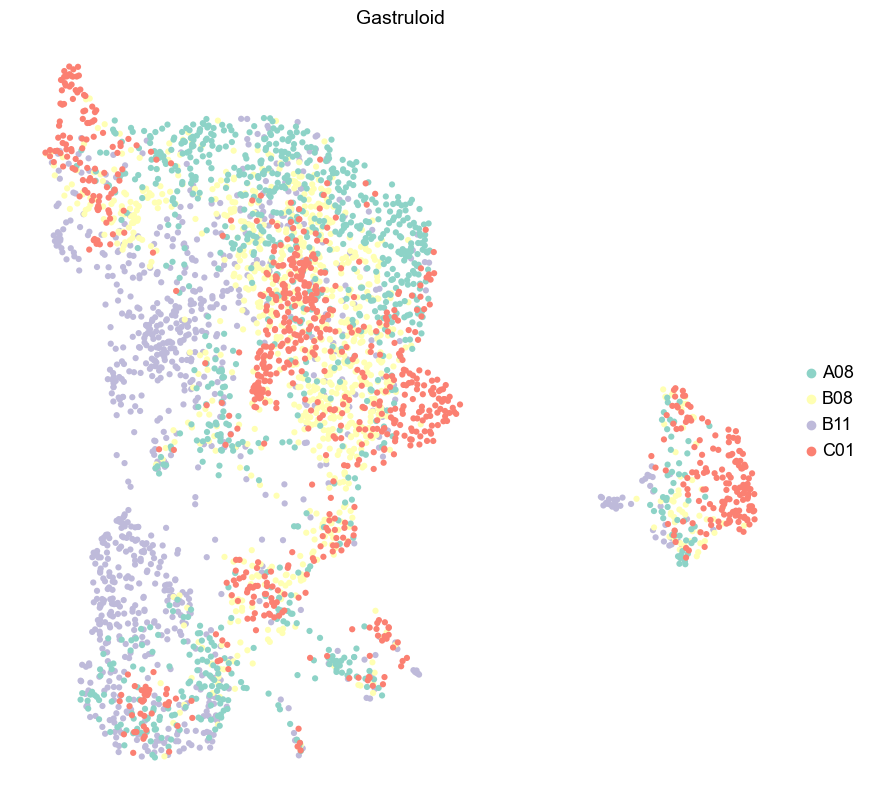

In [57]:
cols = sns.color_palette("Set3") + sns.color_palette("tab10_r")
fig, ax = plt.subplots(figsize=(10,10))

ax=sc.pl.umap(adata, color='Gastruloid',ax=ax, palette=cols,size=80, frameon = False)

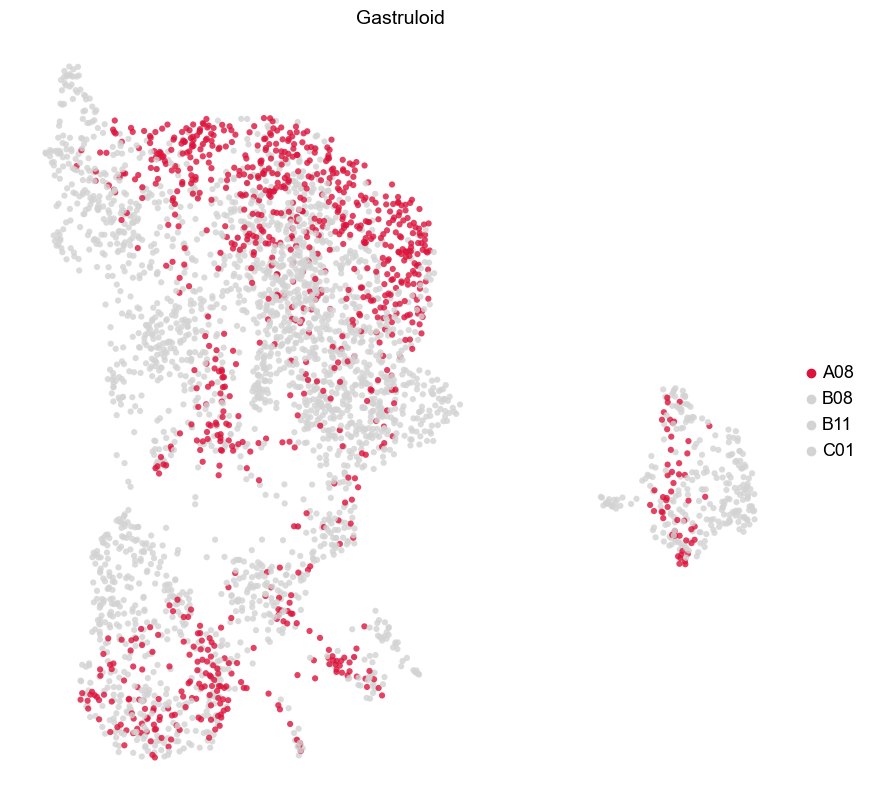

In [58]:
cols = ['crimson','lightgrey','lightgrey','lightgrey']
fig, ax = plt.subplots(figsize=(10,10))

ax=sc.pl.umap(adata, color='Gastruloid',ax=ax, palette=cols,size=80, frameon = False,alpha =0.8)

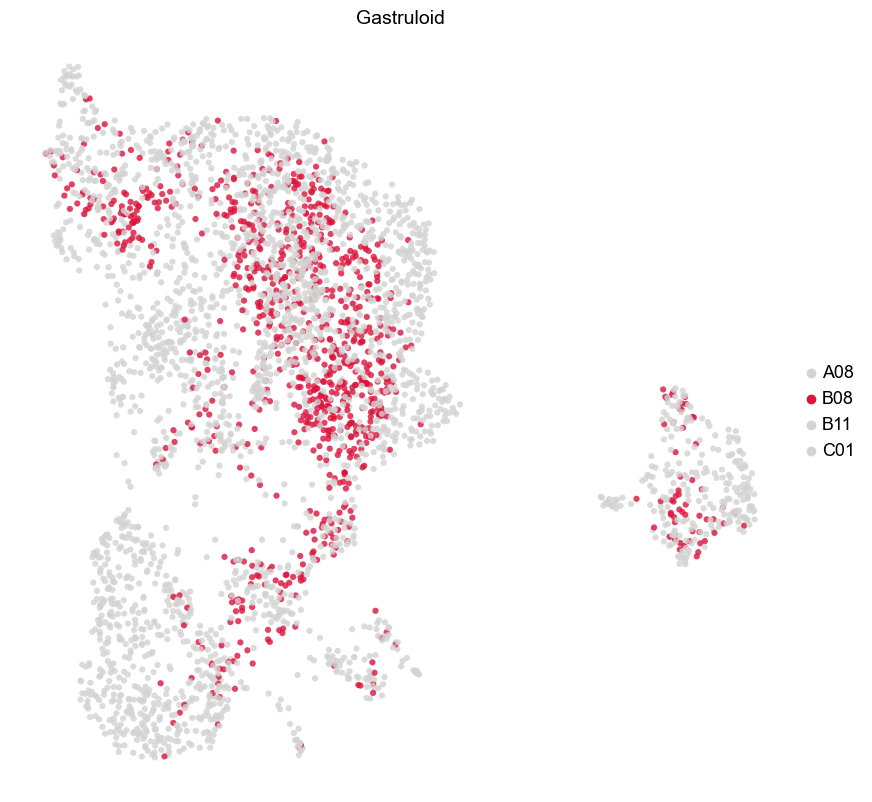

In [59]:
cols = ['lightgrey','crimson','lightgrey','lightgrey']
fig, ax = plt.subplots(figsize=(10,10))

ax=sc.pl.umap(adata, color='Gastruloid',ax=ax, palette=cols,size=80, frameon = False,alpha =0.8)

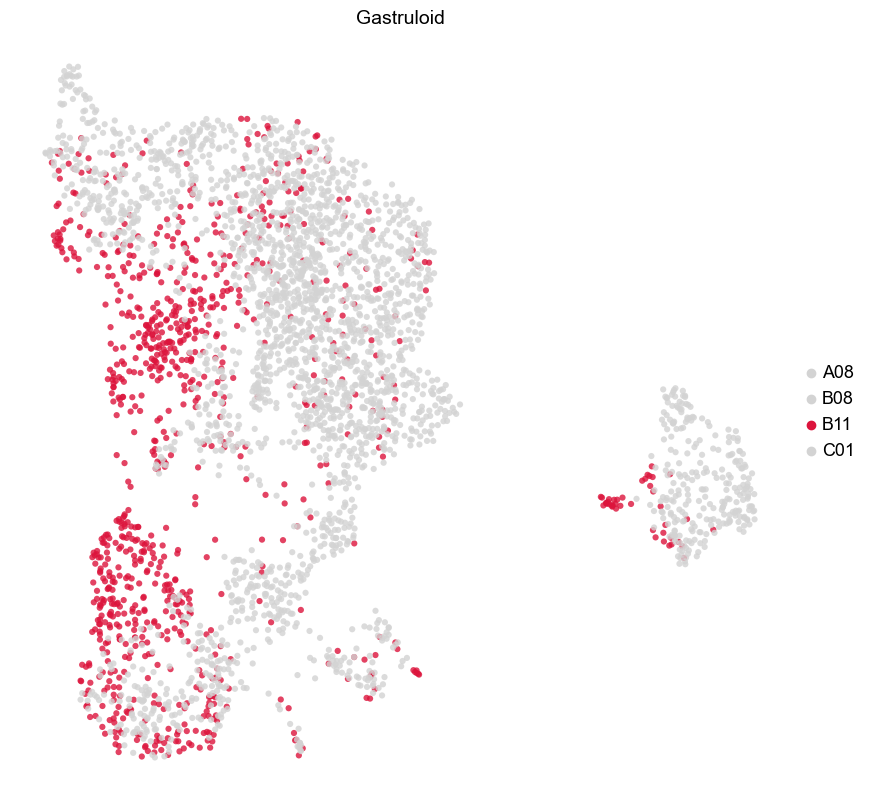

In [60]:
cols = ['lightgrey','lightgrey','crimson','lightgrey']
fig, ax = plt.subplots(figsize=(10,10))

ax=sc.pl.umap(adata, color='Gastruloid',ax=ax, palette=cols,size=80, frameon = False,alpha =0.8)

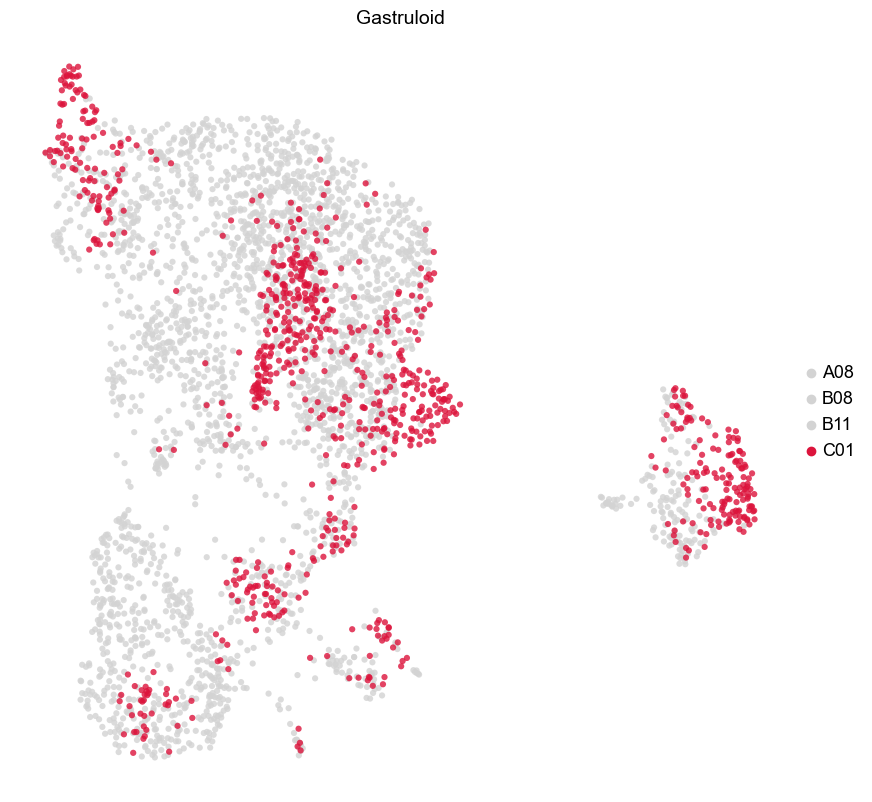

In [61]:
cols = ['lightgrey','lightgrey','lightgrey','crimson']
fig, ax = plt.subplots(figsize=(10,10))

ax=sc.pl.umap(adata, color='Gastruloid',ax=ax, palette=cols,size=80, frameon = False,alpha =0.8)

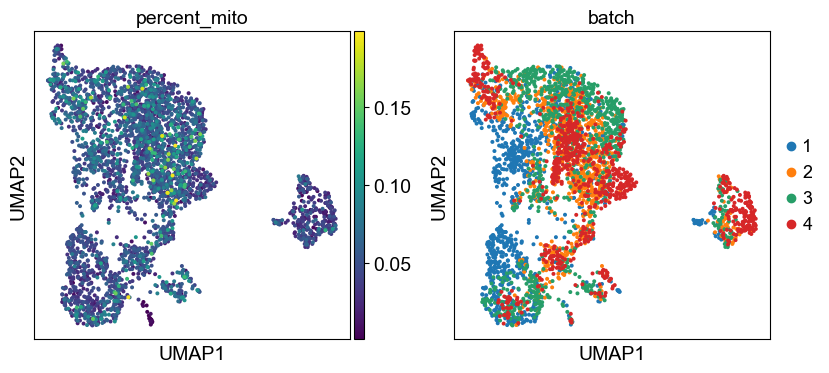

In [62]:
sc.pl.umap(adata, color=['percent_mito', 'batch'], use_raw=True)

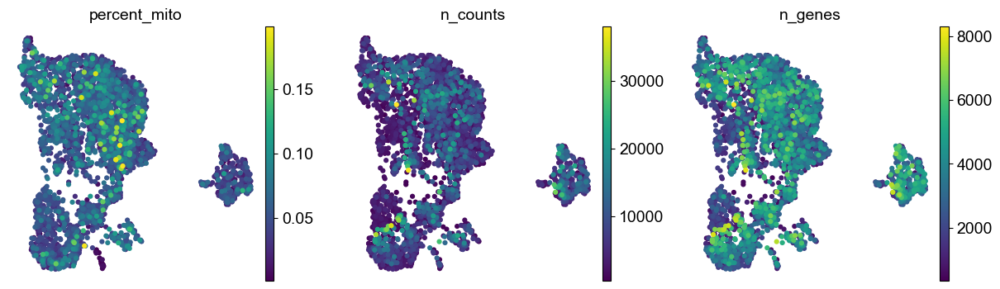

In [63]:
sc.pl.umap(adata, color=['percent_mito','n_counts', 'n_genes'], use_raw=True, frameon=False,size = 80)

## Clustering the neighborhood graph

As Seurat and many others, we recommend the Louvain graph-clustering method (community detection based on optimizing modularity). It has been proposed for single-cell data by [Levine et al. (2015)](https://doi.org/10.1016/j.cell.2015.05.047). Note that Louvain clustering directly clusters the neighborhood graph of cells, which we already computed in the previous section.

In [139]:
sc.tl.leiden(adata, resolution = 1.2)

running Leiden clustering
    finished (0:00:00)


Plot the clusters, which agree quite well with the result of Seurat.

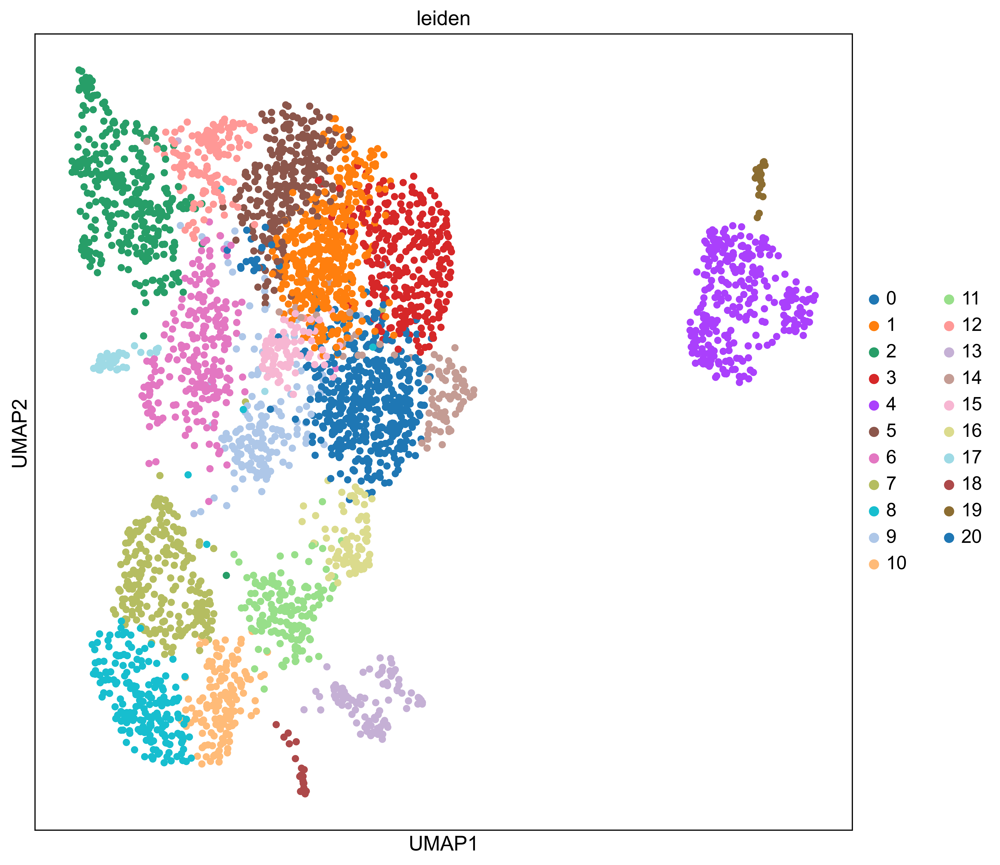

In [141]:
fig, ax = plt.subplots(figsize=(10,10))
sc.pl.umap(adata, color='leiden',ax=ax, palette=sc.pl.palettes.default_20,size=100)

Save the result.

In [86]:
adata.write(results_file)

Make a violin plot of all highly variable genes.

In [87]:
#sc.pl.stacked_violin(adata, figsize = (12,6),palette = sns.color_palette('winter', 42), var_names = adata.var_names[adata.var['highly_variable'] & (np.log(adata.var['means'])>-1)])
#palette=sc.pl.palettes.default_64,

You can also make a heatmap. ! this takes a bit of time to compute.

In [88]:
#sc.pl.heatmap(adata, var_names = adata.var_names[adata.var['highly_variable'] & (np.log(adata.var['means'])>-1)])

## Finding marker genes

Let us compute a ranking for the highly differential genes in each cluster. For this, by default, the `.raw` attribute of AnnData is used in case it has been initialized before. The simplest and fastest method to do so is the t-test.

The result of a [Wilcoxon rank-sum (Mann-Whitney-U)](https://de.wikipedia.org/wiki/Wilcoxon-Mann-Whitney-Test) test is very similar. We recommend using the latter in publications, see e.g., [Sonison & Robinson (2018)](https://doi.org/10.1038/nmeth.4612). You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.

As an alternative, let us rank genes using logistic regression. For instance, this has been suggested by [Natranos et al. (2018)](https://doi.org/10.1101/258566). The essential difference is that here, we use a multi-variate appraoch whereas conventional differential tests are uni-variate. [Clark et al. (2014)](https://doi.org/10.1186/1471-2105-15-79) has more details.

In [216]:
sc.settings.verbosity = 2  # reduce the verbosity

ranking genes
    finished (0:00:21)


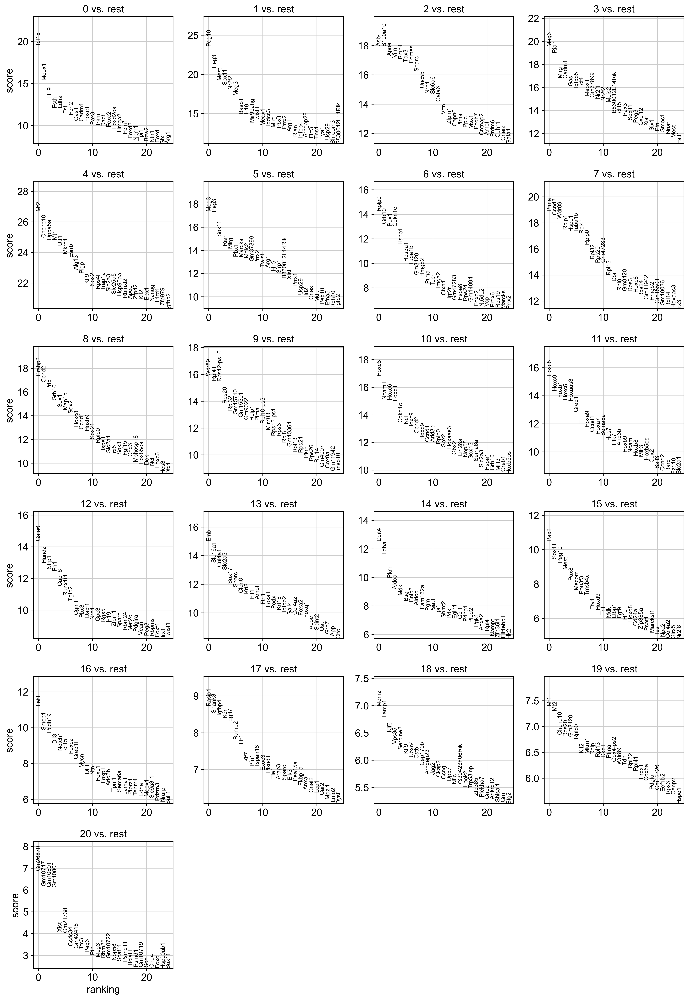

In [217]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

Show the 10 top ranked genes per cluster 0, 1, ..., 7 in a dataframe.
Columns are louvain clusters.

In [221]:
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(10)

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,Tcf15,Peg10,Asb4,Meg3,Mt2,Meg3,Rplp0,Ptma,Crabp2,Wdr89,...,Hoxc8,Gata6,Emb,Ddit4,Pax2,Lef1,Rasip1,Mdm2,Mt1,Gm26870
1,Meox1,Peg3,S100a10,Rian,Chchd10,Peg3,Grb10,Ccnd2,Ccnd2,Rpl41,...,Hoxc9,Hand2,Slc16a1,Ldha,Sox11,Smoc1,Shank3,Lamp1,Mt2,Gm10717
2,H19,Mest,Apoe,Mirg,Dppa5a,Sox11,Pbx1,Wdr89,Prtg,Rps12-ps10,...,Foxb1,Sfrp1,Col4a1,Pkm,Peg10,Pcdh19,Igfbp4,Klf6,Chchd10,Gm10801
3,Fstl1,Sox11,Vim,Cadm1,Mt1,Rian,Cdkn1c,Rplp1,Grb10,Rps20,...,Hoxc6,Fn1,Slc2a3,Aldoa,Mest,Dll3,Kdr,Vps35,Rps20,Gm10800
4,Ldha,Nr2f2,Bmp4,Gas1,Utf1,Mirg,Hspe1,Hspe1,Sox1,Rpl32,...,Hoxaas3,Capn6,Sox17,Mdk,Pax8,Notch1,Egfl7,Serpine2,Gm8420,Xist
5,Fst,Meg3,Tbx3,Igfbp5,Mkrn1,Pbx1,Rps3a1,Tuba1b,Map1b,Gm15710,...,Greb1,Runx1t1,Sparc,Bsg,Mecom,Tcf15,Ramp2,Klf9,Rplp0,Gm21738
6,Fbn2,Basp1,Eomes,Tcf4,Esrrb,Marcks,Tuba1b,Rpl41,Sox2,Gm15501,...,T,Tgfb2,Cldn6,Bnip3,Pou3f3,Foxc2,Flt1,Ubxn4,Klf2,Ccdc34
7,Gas1,H19,Sparc,Meox1,Alg13,Meis2,Gm8420,Rplp0,Hoxc8,Gm9022,...,Hoxa9,Cgnl1,Krt8,Aldoc,Tmsb4x,Greb1l,Klf7,Cstb,Mkrn1,Gm42418
8,Cadm1,Mir99ahg,Unc5b,Gm37899,Pigp,Gm37899,Hmgb2,Rpl32,Ccnd1,Rplp1,...,Ccnd1,Pbx3,Flt1,Fam162a,Etv4,Mycn,Pfn1,Cep170b,Rplp1,Ttc3
9,Foxc1,Twist1,Nrp1,Nr2f1,Klf9,Prrx2,Ptma,Rps20,Hoxb9,Ptma,...,Hoxa7,Dact1,Amot,Pgm1,Hoxd9,Dll1,Tspan18,Arhgap23,Rpl13,Peg3


Get a table with the scores and groups.

In [222]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']}).head(5)

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,...,16_n,16_p,17_n,17_p,18_n,18_p,19_n,19_p,20_n,20_p
0,Tcf15,1.665229e-84,Peg10,1.718238e-123,Asb4,2.970010e-72,Meg3,1.373521e-85,Mt2,2.809588e-157,...,Lef1,3.257515e-29,Rasip1,2.485156e-18,Mdm2,2.613789e-12,Mt1,1.353352e-13,Gm26870,5.922460e-12
1,Meox1,9.180072e-54,Peg3,7.299443e-97,S100a10,3.766367e-72,Rian,7.835118e-81,Chchd10,8.331740e-138,...,Smoc1,4.943057e-23,Shank3,1.319312e-17,Lamp1,1.085080e-11,Mt2,2.708842e-13,Gm10717,6.177367e-10
2,H19,7.824090e-41,Mest,4.632994e-83,Apoe,4.830201e-67,Mirg,9.771830e-64,Dppa5a,2.211758e-136,...,Pcdh19,2.022507e-22,Igfbp4,2.138158e-17,Klf6,6.853618e-11,Chchd10,7.587657e-12,Gm10801,7.830720e-10
3,Fstl1,7.130101e-34,Sox11,5.990731e-78,Vim,3.093488e-66,Cadm1,2.020502e-63,Mt1,3.149769e-136,...,Dll3,6.542778e-20,Kdr,4.130407e-17,Vps35,2.932215e-10,Rps20,9.270436e-12,Gm10800,8.760891e-10
4,Ldha,7.202820e-34,Nr2f2,2.136597e-73,Bmp4,1.171441e-65,Gas1,1.351957e-58,Utf1,3.131797e-132,...,Notch1,2.283904e-18,Egfl7,8.993862e-17,Serpine2,5.577141e-10,Gm8420,9.852544e-12,Xist,4.364914e-05


In [223]:
rank_genes_groups = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']})

rank_genes_groups.head()

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,...,16_n,16_p,17_n,17_p,18_n,18_p,19_n,19_p,20_n,20_p
0,Tcf15,1.665229e-84,Peg10,1.718238e-123,Asb4,2.970010e-72,Meg3,1.373521e-85,Mt2,2.809588e-157,...,Lef1,3.257515e-29,Rasip1,2.485156e-18,Mdm2,2.613789e-12,Mt1,1.353352e-13,Gm26870,5.922460e-12
1,Meox1,9.180072e-54,Peg3,7.299443e-97,S100a10,3.766367e-72,Rian,7.835118e-81,Chchd10,8.331740e-138,...,Smoc1,4.943057e-23,Shank3,1.319312e-17,Lamp1,1.085080e-11,Mt2,2.708842e-13,Gm10717,6.177367e-10
2,H19,7.824090e-41,Mest,4.632994e-83,Apoe,4.830201e-67,Mirg,9.771830e-64,Dppa5a,2.211758e-136,...,Pcdh19,2.022507e-22,Igfbp4,2.138158e-17,Klf6,6.853618e-11,Chchd10,7.587657e-12,Gm10801,7.830720e-10
3,Fstl1,7.130101e-34,Sox11,5.990731e-78,Vim,3.093488e-66,Cadm1,2.020502e-63,Mt1,3.149769e-136,...,Dll3,6.542778e-20,Kdr,4.130407e-17,Vps35,2.932215e-10,Rps20,9.270436e-12,Gm10800,8.760891e-10
4,Ldha,7.202820e-34,Nr2f2,2.136597e-73,Bmp4,1.171441e-65,Gas1,1.351957e-58,Utf1,3.131797e-132,...,Notch1,2.283904e-18,Egfl7,8.993862e-17,Serpine2,5.577141e-10,Gm8420,9.852544e-12,Xist,4.364914e-05


In [224]:
rank_genes_groups.to_csv(pathToData + 'rank_genes_groups_leidenclusters.csv')

### Define marker genes per cluster, based on the table above

!!! old clusters !!!

Louvain clusters | 0 | 1 | 2 | 3 | 4 | 5 | 6 | 7 | 8 | 9 | 10 | 11 | 12 | 13
---|---|---|---|---|---|---|---|---|---|---|---|---|---|---
0 | Peg3 | Ncam1 | Nrp1 | Cdkn1a | Rspo3 | Meox1 | Ncam1 | Cenpf | Sema6a | Ptn | Pcdh19 | Cdh1 | Shank3 | Trp53i11
1 | Rdh10 | Sox2 | Gata6 | Mdm2 | Dll1 | Nr2f2 | Hoxc8 | Top2a | Rspo3 | Sox1 | Lef1 | Trh | Kdr | Elavl3
2 | Prrx1 | Slc2a1 | Peg10 | Trp53inp1 | Tbx6 | Cadm1 | Slc2a3 | Arl6ip1 | T | Sox21 | Notch1 | Klf5 | Igfbp4 | Map1b
3 | Prrx2 | Sox1 | Unc5c | Ccng1 | Lef1 | Pax3 | Nkx1-2 | Plk1 | Hoxc8 | Tmsb4x | Foxc2 | Mt2 | Tspan18 | Tmsb4x
4 | Pbx1 | Crabp2 | Runx1t1 | Lamp1 | Nrarp | Tcf15 | Sox2 | Ccnb1 | Fgf17 | Map1b | Foxp1 | Mt1 | Egfl7 | Mkrn1
5 | Cd24a | Ptn | Nfxl1 | Sqstm1 | Rnf213 | Gas1 | Hoxb9 | Aspm | Hoxaas3 | Fabp7 | Efnb2 | Gpx1 | Dusp2 | Onecut2
6 | Tgfb2 | Hoxc8 | Bmp4 | Perp | Dll3 | Eya1 | Hoxaas3 | Tacc3 | Hes7 | Prss23 | Pcdh8 | Nanog | Ramp2 | Rnf165
7 | Meis2 | Hoxb9 | Capn6 | Klf9 | Pcdh19 | Nav1 | Gbx2 | Spc25 | Foxb1 | Sparc | Foxc1 | Ephx2 | Flt1 | Hes6
8 | Hmga2 | Slc2a3 | Msx1 | Stx3 | Pea15a | Fbn2 | Hoxc9 | Ube2c | Pabpc1 | Epha4 | Aldh1a2 | Tpd52 | Ets1 | Cdkn1c
9 | Twist1 | Sox13 | Sparc | Atp6v0b | Hes7 | Hmga2 | Mllt3 | Prrx1 | Hoxc6 | Rtn3 | Epb41l3 | Slc2a3 | Car2 | Crmp1


### !!! New !!!
Louvain clusters | 0 | 1 | 2 | 3 | 4 | 5 | 6 | 7 | 8 | 9 | 10 | 11 | 12 | 13 | 14
---|---|---|---|---|---|---|---|---|---|---|---|---|---|---|---
0 | Fn1 | Hoxc8 | Nrp1 | Rspo3 | Cdkn1a | Rdh10 | Sema6a | Sox1 | Meox1 | Ptn | Pcdh19 | Mt2 | Gm10801 | Shank3 | Slc16a1
1 | Peg3 | Ncam1 | Gata6 | Dll1 | Mdm2 | Peg3 | T | Crabp2 | Tcf15 | Sox1 | Lef1 | Mt1 | Gm10800 | Kdr | Cldn6
2 | Pbx1 | Slc2a3 | Runx1t1 | Tbx6 | Ccng1 | Prrx2 | Hoxc8 | Sox2 | Pax3 | Tmsb4x | Foxc2 | Utf1 | Gm10717 | Egfl7 | Emb
3 | Prrx1|Nkx1-2|Peg10|Lef1|Trp53inp1|Meis2|Rspo3|Ncam1|Cadm1|Map1b|Notch1|Klf5|Gm21738|Tspan18|Sox17
4 | Fstl1|Sox2|Unc5c|Nrarp|Lamp1|Mest|Hoxaas3|Ptn|Nr2f2|Sox21|Foxp1|Cdh1|Gm26870|Igfbp4|Igfbp2
5|Prrx2|Hoxb9|Nfxl1|Rnf213|Perp|Fzd2|Pabpc1|Dtx4|Nav1|Fabp7|Efnb2|Nanog|Gm10722|Dusp2|Trh
6|Cdh11|Gbx2|Hand2|Dll3|Sqstm1|Pbx1|Greb1|Map1b|Foxd1|Epha4|Pcdh8|Ephx2|Gm10719|Ets1|Col4a1
7|Sfrp1|Hoxaas3|Rgs5|Pcdh19|Stx3|Nr2f2|Hes7|Slc2a1|Nnat|Prss23|Foxc1|L1td1|Gm11168|Ramp2|Fth1
8|Emb|Slc2a1|Capn6|Pea15a|Klf9|Twist1|Foxb1|Fgfbp3|Foxc2|Rtn3|Epb41l3|Slc25a5|Gm10720|Fli1|Slc2a3
9|Rdh10|Hoxc6|Bmp4|Hes7|Atp6v0b|Prrx1|Fgf17|Sox13|Foxp1|Sparc|Cadm1|Zfp979|Gm10715|Flt1|Sorl1

### Cluster 0/6 - Early endoderm??

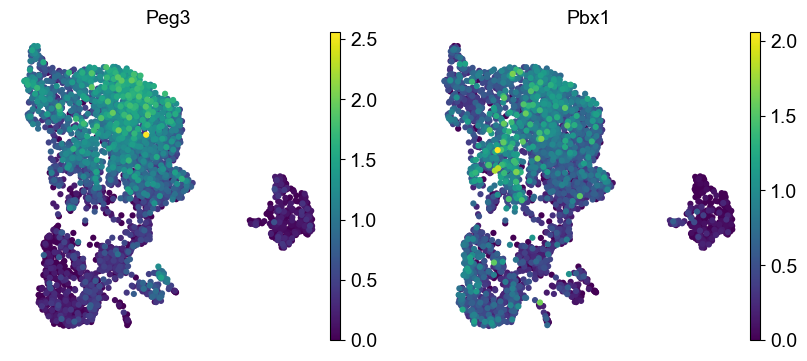

In [64]:
sc.pl.umap(adata, color=['Peg3', 'Pbx1'], use_raw=True, frameon=False, size = 80)

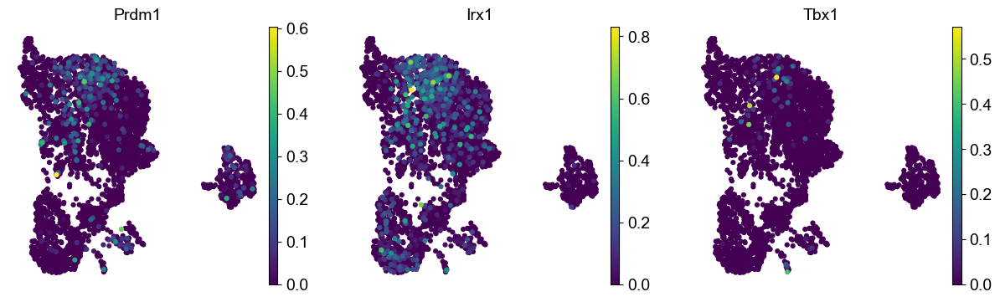

In [65]:
sc.pl.umap(adata, color=['Prdm1', 'Irx1', 'Tbx1'], use_raw=True, frameon=False, size = 80)

### Cluster 1 - Early heart progenitors

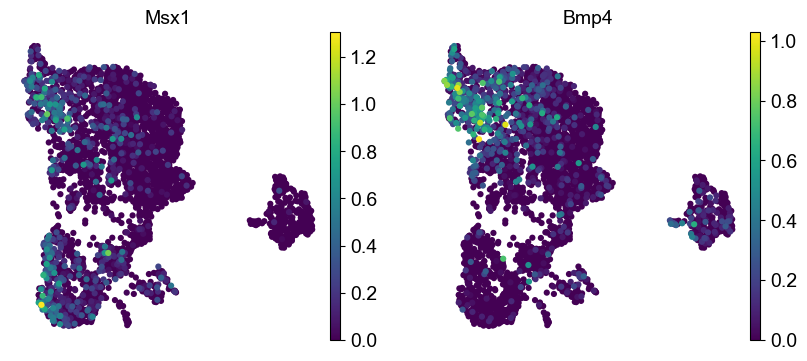

In [66]:
sc.pl.umap(adata, color=['Msx1', 'Bmp4'], use_raw=True, frameon=False, size = 80)

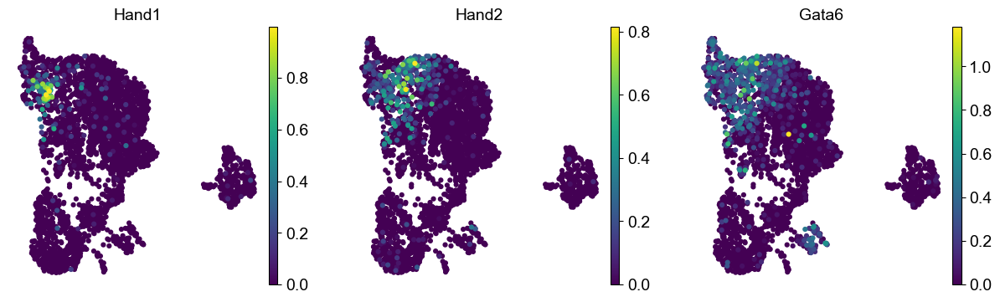

In [67]:
sc.pl.umap(adata, color=['Hand1', 'Hand2', 'Gata6'], use_raw=True, frameon=False, size = 80)

### Cluster 2/4 - Neurons

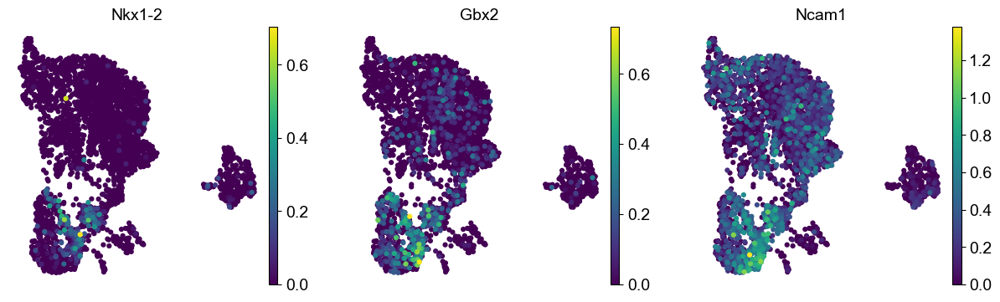

In [68]:
sc.pl.umap(adata, color=['Nkx1-2', 'Gbx2', 'Ncam1'], frameon=False, size = 80)

### Cluster 3 - Presomitic mesoderm

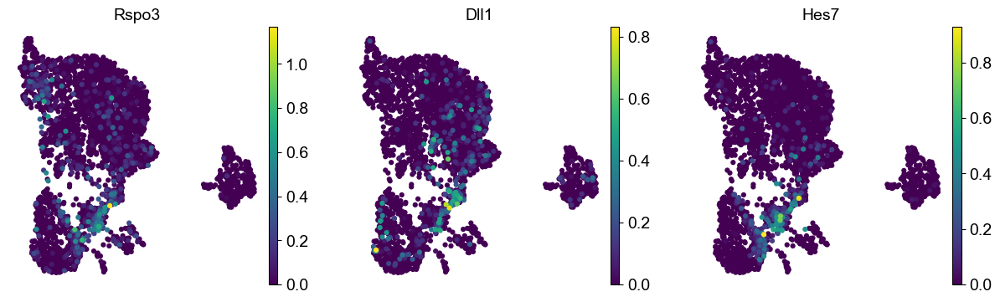

In [69]:
sc.pl.umap(adata, color=['Rspo3', 'Dll1', 'Hes7'], use_raw=True, frameon=False, size = 80)

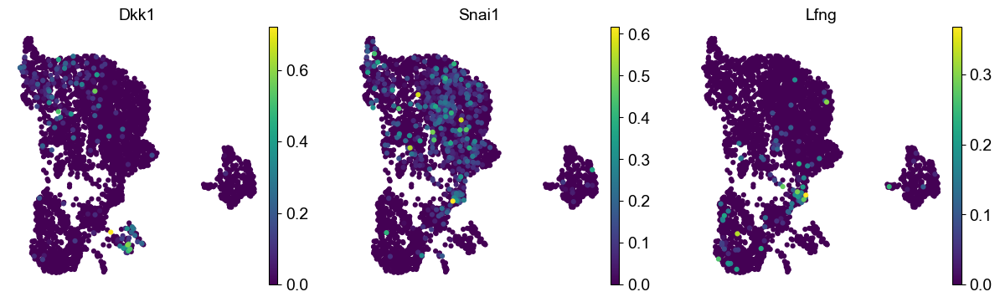

In [70]:
sc.pl.umap(adata, color=['Dkk1', 'Snai1', 'Lfng'], use_raw=True, frameon=False, size = 80)

### Cluster 5 - allantois + ?

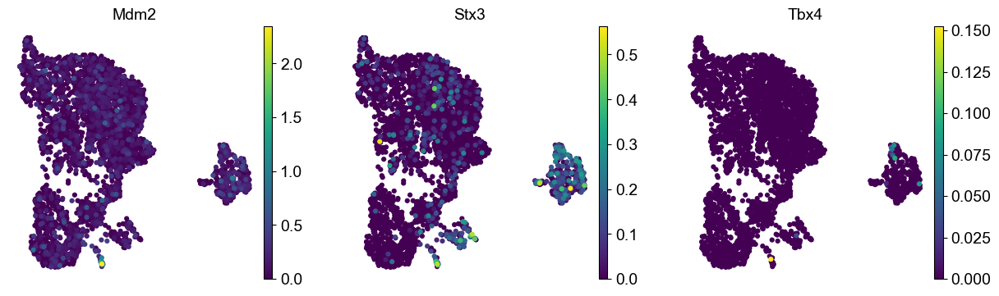

In [71]:
sc.pl.umap(adata, color=['Mdm2', 'Stx3', 'Tbx4'], use_raw=True, frameon=False, size = 80)

### Cluster 7 - Tailbud

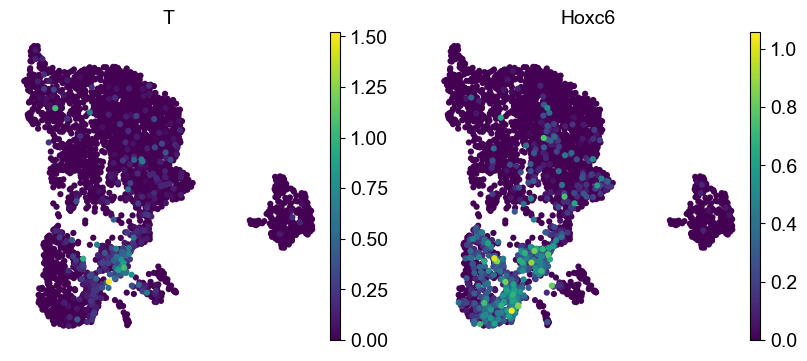

In [72]:
sc.pl.umap(adata, color=['T', 'Hoxc6'], use_raw = True, frameon=False, size = 80)

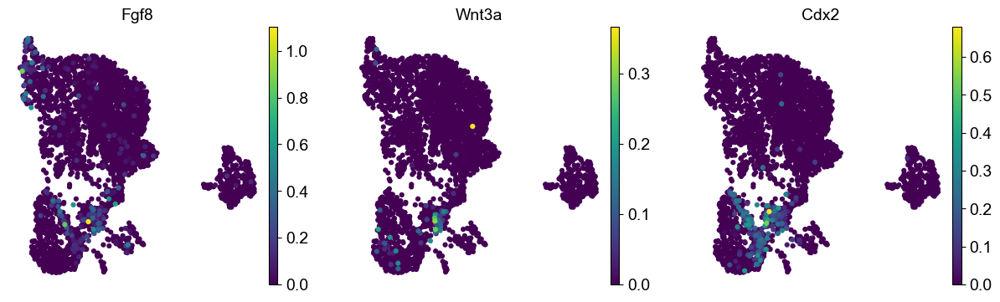

In [73]:
sc.pl.umap(adata, color=['Fgf8', 'Wnt3a', 'Cdx2'], use_raw=True, frameon=False, size = 80)

### Cluster 4/9 - Neurons

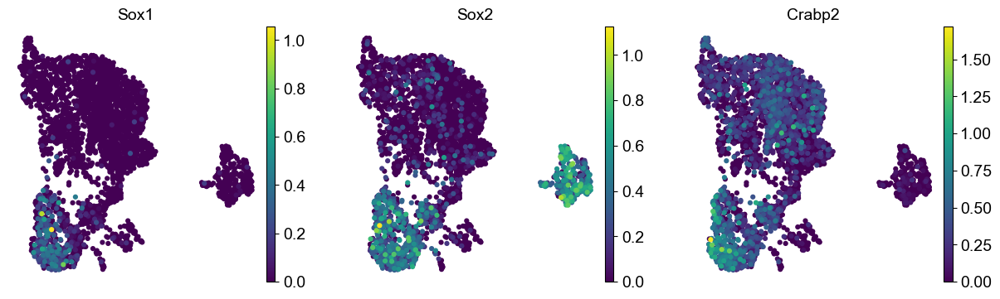

In [74]:
sc.pl.umap(adata, color=['Sox1', 'Sox2', 'Crabp2'], use_raw=True, frameon=False, size = 80)

### Cluster 8 - Early somitic

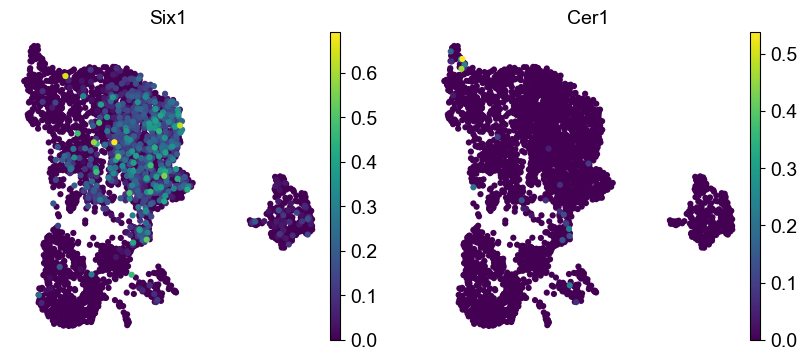

In [75]:
sc.pl.umap(adata, color=['Six1', 'Cer1'], use_raw=True, frameon=False, size = 80)

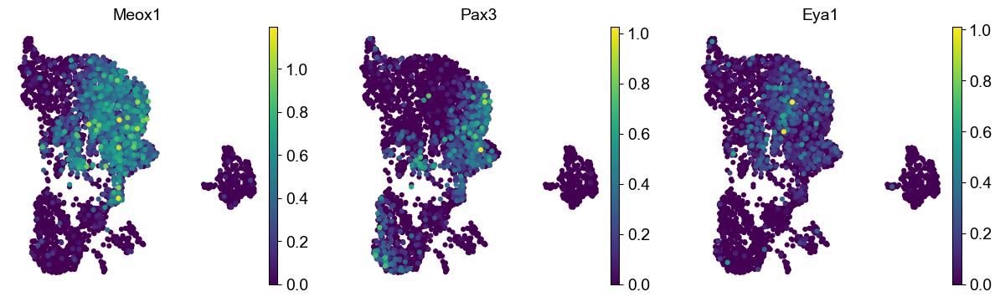

In [76]:
sc.pl.umap(adata, color=['Meox1', 'Pax3', 'Eya1'], use_raw=True, frameon=False, size = 80)

### Cluster 9 - Anterior neural / Neurectoderm

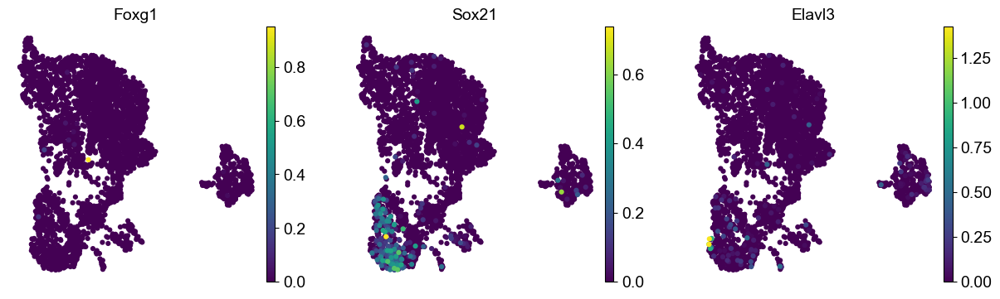

In [77]:
sc.pl.umap(adata, color=['Foxg1', 'Sox21', 'Elavl3'], use_raw = True, frameon=False, size = 80)

#### Cluster 9 - branchial arches

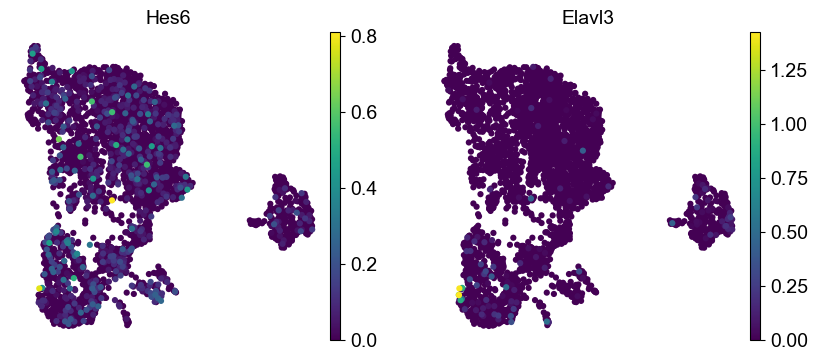

In [78]:
sc.pl.umap(adata, color=['Hes6', 'Elavl3'], use_raw = True, frameon=False, size = 80)

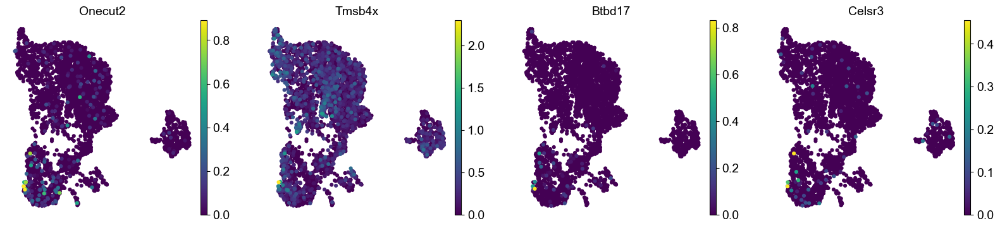

In [79]:
sc.pl.umap(adata, color=['Onecut2', 'Tmsb4x', 'Btbd17','Celsr3'], use_raw = True, frameon=False, size = 80)

### Cluster 10 - Somitogenesis wavefront

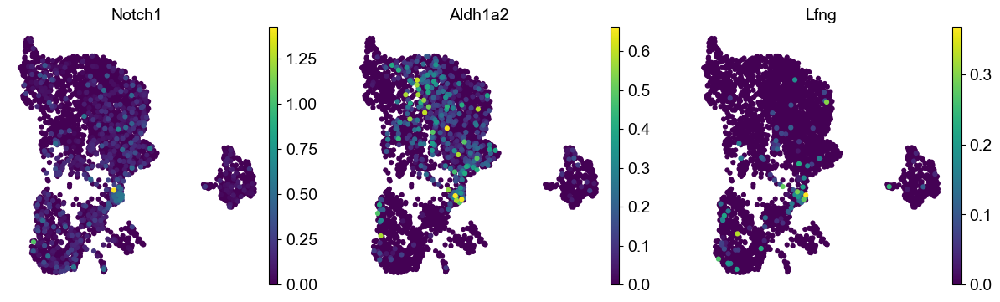

In [80]:
sc.pl.umap(adata, color=['Notch1', 'Aldh1a2', 'Lfng'], use_raw = True, frameon=False, size = 80)

### Cluster 11 - PGCs and node

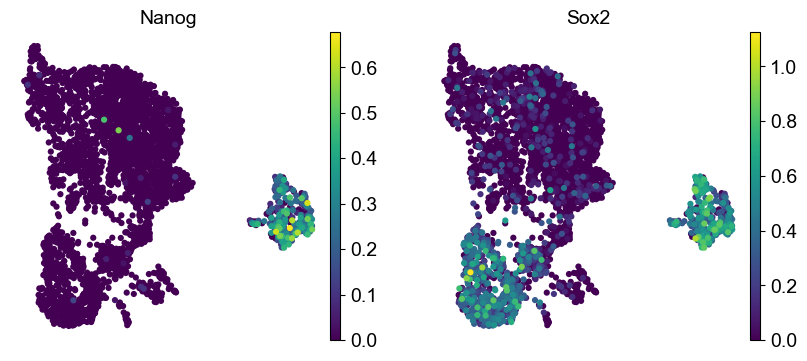

In [81]:
sc.pl.umap(adata, color=['Nanog', 'Sox2'], use_raw = True, frameon=False, size = 80)

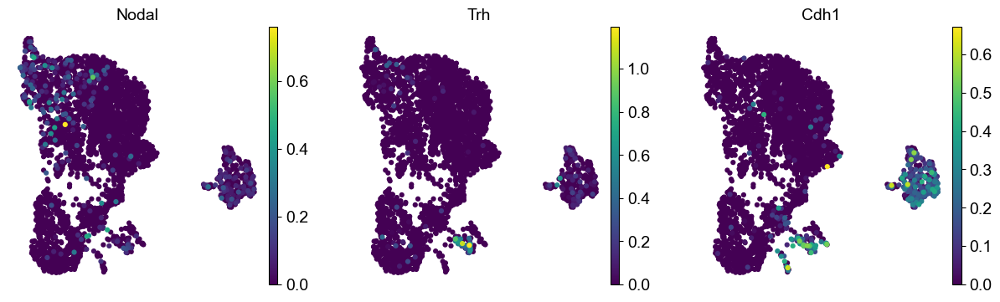

In [82]:
sc.pl.umap(adata, color=['Nodal', 'Trh', 'Cdh1'], use_raw = True, frameon=False, size = 80)

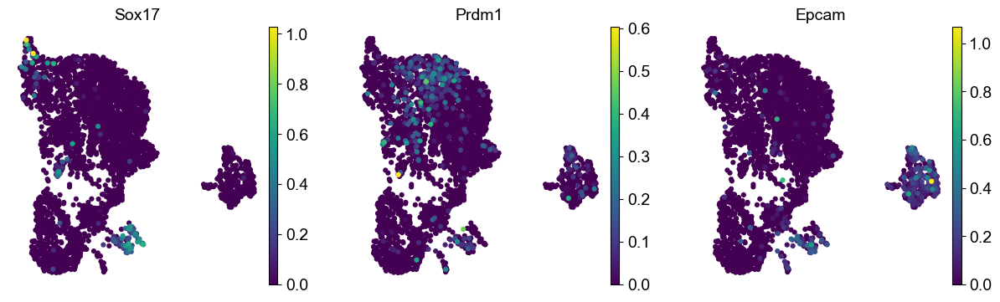

In [83]:
sc.pl.umap(adata, color=['Sox17', 'Prdm1', 'Epcam'], use_raw = True, frameon=False, size = 80)

#### - Node (pit)

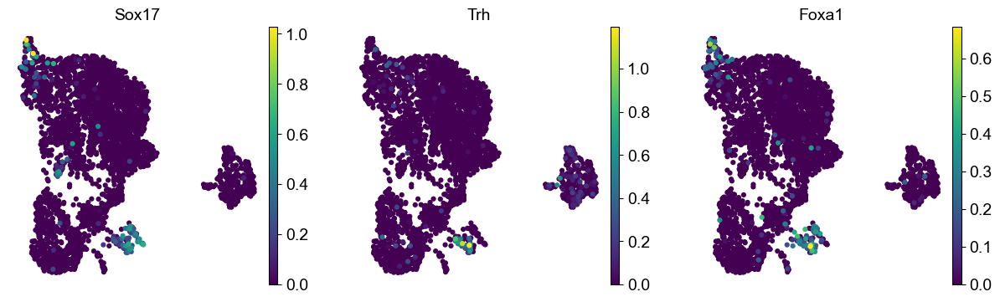

In [84]:
sc.pl.umap(adata, color=['Sox17', 'Trh', 'Foxa1'], use_raw = True, frameon=False, size = 80)

### Cluster 12 - Haemogenic

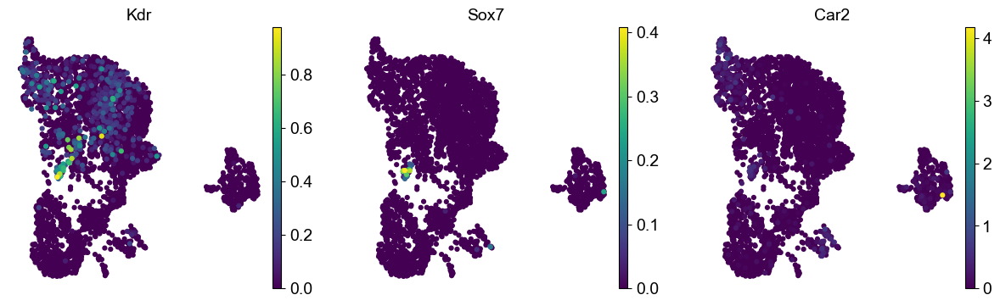

In [85]:
sc.pl.umap(adata, color=['Kdr','Sox7', 'Car2'], use_raw = True, frameon=False, size = 80)

### Hox genes

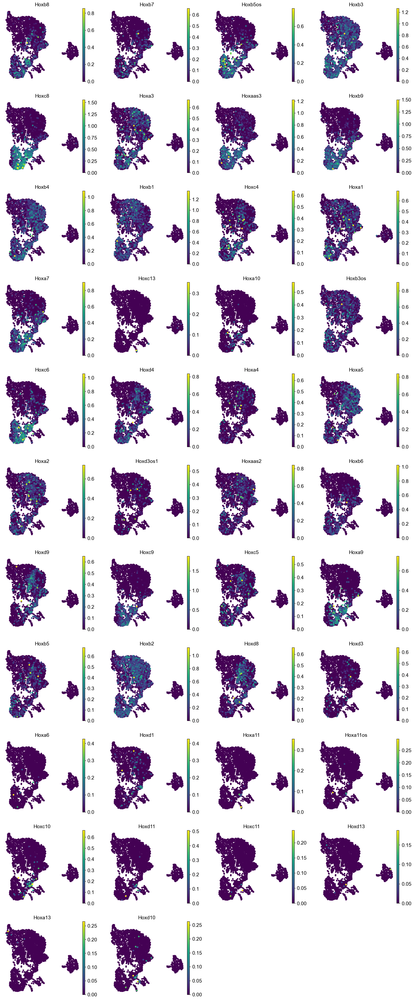

In [86]:
sc.pl.umap(adata, color=adata.var.filter(regex=r'Hox', axis=0).index, use_raw = True, frameon=False, size = 80)

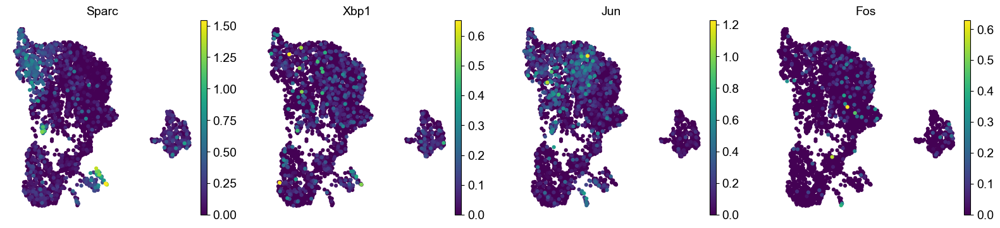

In [87]:
sc.pl.umap(adata, color=['Sparc', 'Xbp1', 'Jun', 'Fos'], use_raw = True, frameon=False, size = 80)

# Cell type classification based on marker genes

Overview of louvain clusters, cell type annotation, known marker genes and marker genes as defined by Scanpy.

### !!! New !!!
Louvain clusters| 0 | 1 | 2 | 3 | 4 | 5 | 6 | 7 | 8 | 9 | 10 | 11 | 12 | 13 | 14
---|---|---|---|---|---|---|---|---|---|---|---|---|---|---|---
**Cell type annotation** | **Early endoderm (?)** | **Neurons** | **Early heart progenitors** | **Presomitic mesoderm** | **Allantois (?)** | **Early endoderm (?)** | **Tailbud** |**Neurons** | **Early somitic** | **Anterior neural / Neurectoderm + branchial arches** | **Somitogenesis wavefront** | **PGCs** | **GM genes ?** | **Haemogenic** | **Node pit**
---|---|---|---|---|---|---|---|---|---|---|---|---|---|---|---
0 | Fn1 | Hoxc8 | Nrp1 | Rspo3 | Cdkn1a | Rdh10 | Sema6a | Sox1 | Meox1 | Ptn | Pcdh19 | Mt2 | Gm10801 | Shank3 | Slc16a1
1 | Peg3 | Ncam1 | Gata6 | Dll1 | Mdm2 | Peg3 | T | Crabp2 | Tcf15 | Sox1 | Lef1 | Mt1 | Gm10800 | Kdr | Cldn6
2 | Pbx1 | Slc2a3 | Runx1t1 | Tbx6 | Ccng1 | Prrx2 | Hoxc8 | Sox2 | Pax3 | Tmsb4x | Foxc2 | Utf1 | Gm10717 | Egfl7 | Emb
3 | Prrx1|Nkx1-2|Peg10|Lef1|Trp53inp1|Meis2|Rspo3|Ncam1|Cadm1|Map1b|Notch1|Klf5|Gm21738|Tspan18|Sox17
4 | Fstl1|Sox2|Unc5c|Nrarp|Lamp1|Mest|Hoxaas3|Ptn|Nr2f2|Sox21|Foxp1|Cdh1|Gm26870|Igfbp4|Igfbp2
5|Prrx2|Hoxb9|Nfxl1|Rnf213|Perp|Fzd2|Pabpc1|Dtx4|Nav1|Fabp7|Efnb2|Nanog|Gm10722|Dusp2|Trh
6|Cdh11|Gbx2|Hand2|Dll3|Sqstm1|Pbx1|Greb1|Map1b|Foxd1|Epha4|Pcdh8|Ephx2|Gm10719|Ets1|Col4a1
7|Sfrp1|Hoxaas3|Rgs5|Pcdh19|Stx3|Nr2f2|Hes7|Slc2a1|Nnat|Prss23|Foxc1|L1td1|Gm11168|Ramp2|Fth1
8|Emb|Slc2a1|Capn6|Pea15a|Klf9|Twist1|Foxb1|Fgfbp3|Foxc2|Rtn3|Epb41l3|Slc25a5|Gm10720|Fli1|Slc2a3
9|Rdh10|Hoxc6|Bmp4|Hes7|Atp6v0b|Prrx1|Fgf17|Sox13|Foxp1|Sparc|Cadm1|Zfp979|Gm10715|Flt1|Sorl1

### old
Louvain Group | Cell type | Known marker genes | Scanpy marker genes
---|---|---|---
0 | Early endoderm (?) | Prdm1, Irx1 | Peg3, Prrx1, Prrx2, Pbx1, Meis2
1 | Neurons | Sox1, Sox2 | Sox1, Sox2, Sox13, Ncam1, Crabp2
2 | Early heart progenitors | Bmp4, Gata4, Gata6, Hand1, Hand2 | Bmp4, Runx1t1, Gata6, Msx1, Nrp1, Peg10
3 | Allantois (?) | Tbx4 | Mdm2, Klf9, Stx3, Cdkn1a, Ccng1
4 | Presomitic mesoderm | Dll1, Hes7, Snai1, Hes5, Dkk1, Lfng | Dll1, Hes7, Rspo3, Dll3, Tbx6
5 | Early somitic | Eya1, Pax3, Six1, Cer1 | Eya1, Pax3, Meox1, Cadm1, Nav1
6 | ` | Sox1, Sox2 | Sox2, Nkx1-2, Gbx2, Hoxc8, Hoxb9, Hoxc9
7 | Early endoderm (?) | Prdm1, Irx1 | Prrx1, Ube2c, Ccnb1, Plk1, Cenpf
8 | Tailbud | T, Wnt3a, Cdx2, Fgf8 | T, Foxb1, Fgf17, Rspo3, Hoxc6, Hoxc8, Hes7
9 | Anterior neural / Neurectoderm | Foxg1 | Sox1, Sox21, Tmsb4x, Epha4
10 | Somitogenesis wavefront | Aldh1a2, Notch1, Lfng | Aldh1a2, Notch1, Foxc1, Foxc2, Foxp1, Lef1
11a | PGCs | Sox2, Nanog | Nanog, Mt1, Mt2
11b | Node | Cdh1, Trh, Nodal, Sox17, Epcam | Cdh1, Trh
12 | Haemogenic | Sox7 | Car2, Kdr
13 | Branchial arches | Onecut2, Elavl3, Tmsb4x, Celsr3, Btbd17 | Onecut2, Elavl3, Tmsb4x, Hes6

In [9]:
adata.obs['celltype'] = adata.obs['leiden']
new_cluster_names = ['Presomitic Mesoderm','(Early) Endoderm','Heart Progenitors','Early Somitic','PGCs',
                     '5', 'X',
                     'Anterior Neural',
                     'Neurons','30','10','Tailbud','12','Endoderm','14','Z','Somitogenesis Wavefront/Presomitic',
                     'Haemogenic','Allantois','19','20']


# 'Presomitic Mesoderm', ,'Allantois'

adata.rename_categories('celltype', new_cluster_names)

adata.obs['celltype'] = [sub.replace('30', 'X') for sub in adata.obs['celltype']]
adata.obs['celltype'] = [sub.replace('Z', 'X') for sub in adata.obs['celltype']]
adata.obs['celltype'] = [sub.replace('20', 'X') for sub in adata.obs['celltype']]
adata.obs['celltype'] = [sub.replace('5', '(Early) Endoderm') for sub in adata.obs['celltype']]
adata.obs['celltype'] = [sub.replace('10', 'Neurons') for sub in adata.obs['celltype']]
adata.obs['celltype'] = [sub.replace('12', 'Heart Progenitors') for sub in adata.obs['celltype']]
adata.obs['celltype'] = [sub.replace('14', 'Presomitic Mesoderm') for sub in adata.obs['celltype']]
adata.obs['celltype'] = [sub.replace('19', 'PGCs') for sub in adata.obs['celltype']]
adata.obs['celltype'] = [sub.replace('Anterior Neural', 'Neurons') for sub in adata.obs['celltype']]
adata.obs['celltype'] = [sub.replace('Presomitic Mesoderm', 'Early Somitic') for sub in adata.obs['celltype']]
adata.obs['celltype'] = [sub.replace('X', 'Mesoderm') for sub in adata.obs['celltype']]





/Users/m.blotenburg/miniconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1163: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  self.obs[key].cat.rename_categories(categories, inplace=True)


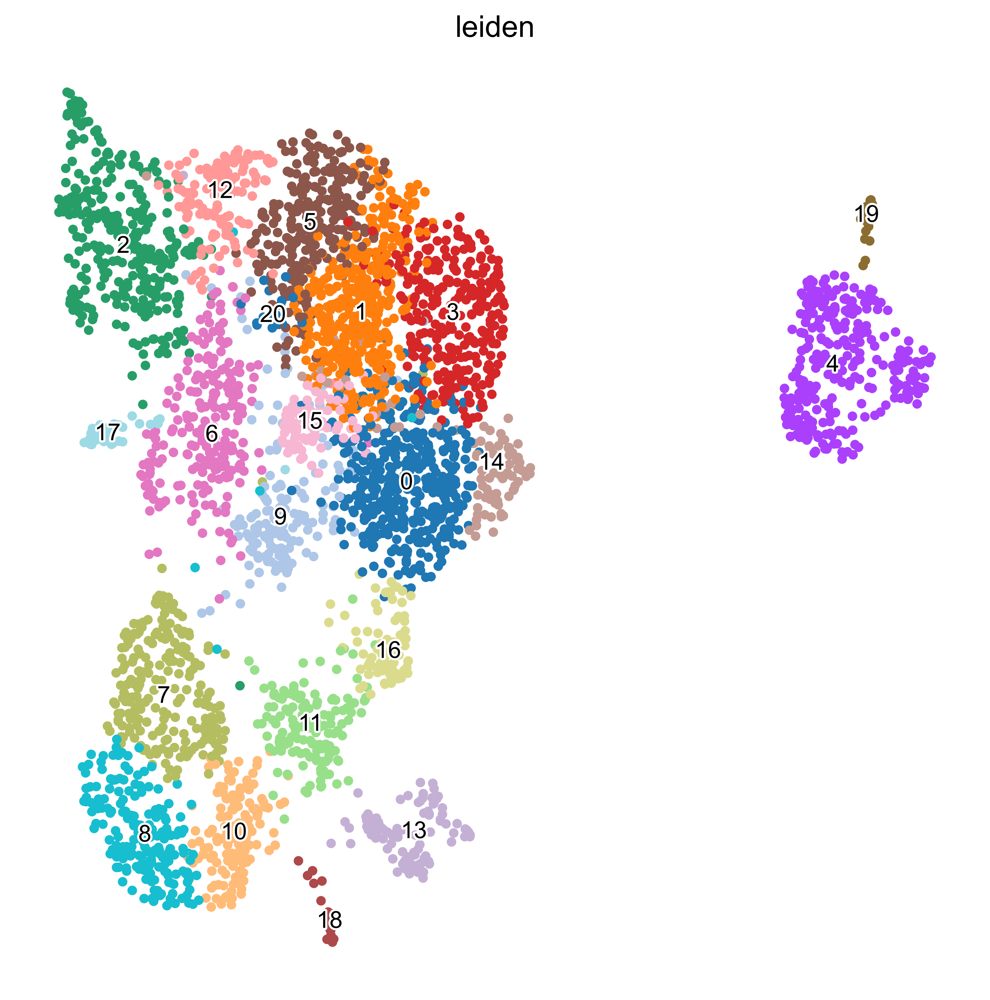

In [13]:
fig,ax = plt.subplots(figsize=(8,8))
ax = sc.pl.umap(adata, color = 'leiden', ax=ax, legend_fontweight='normal',legend_fontsize=11,
                frameon=False,size = 80, legend_loc = 'on data', legend_fontoutline=2)



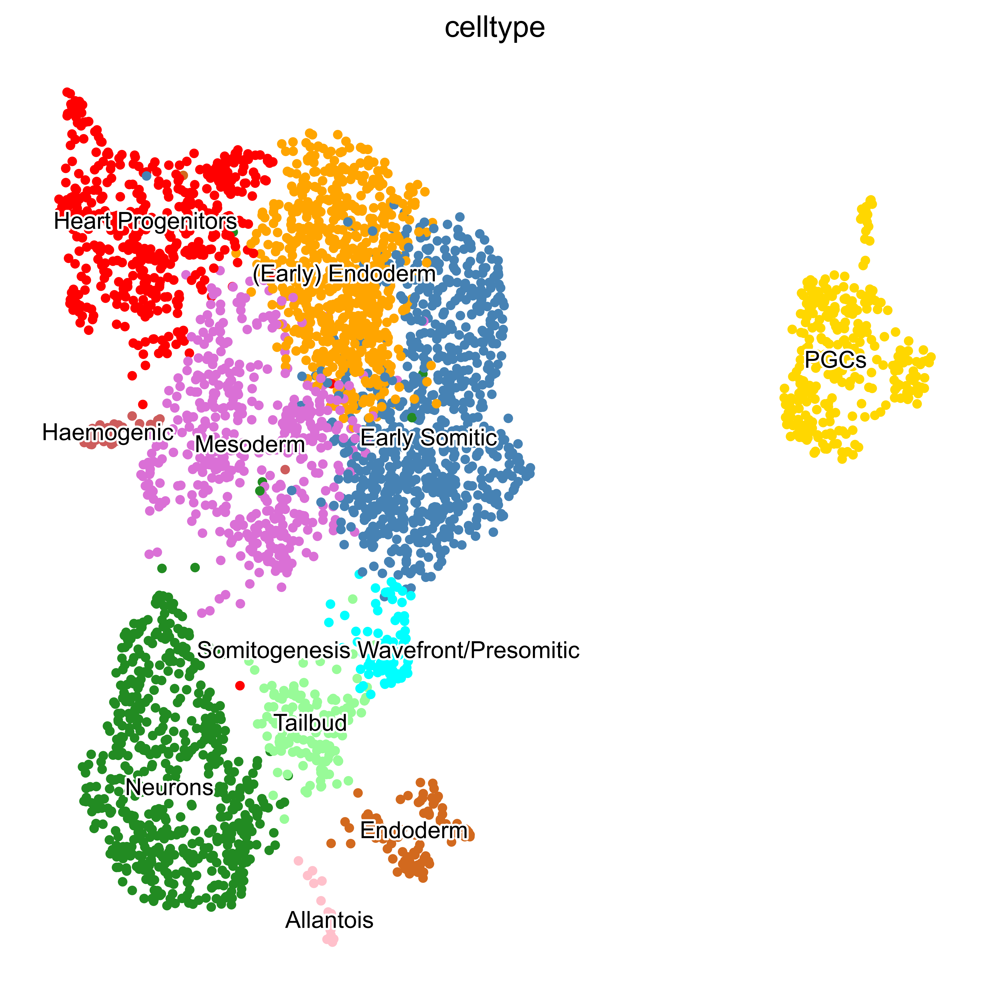

In [14]:
fig,ax = plt.subplots(figsize=(8,8))
ax = sc.pl.umap(adata, color = 'celltype', ax=ax, legend_fontweight='normal',legend_fontsize=11,
                palette = ['orange','pink','steelblue','chocolate','indianred','red','orchid',
                          'forestgreen','gold','cyan','palegreen'],
                frameon=False,size = 80, legend_loc = 'on data', legend_fontoutline=2)


Now that we annotated the cell types, let us visualize the marker genes.

In [15]:
sc.set_figure_params(scanpy=True,dpi=500,frameon=False, fontsize = 14)


In [18]:
order = ['Neurons','Tailbud',  
         'Somitogenesis Wavefront/Presomitic','Early Somitic','Mesoderm',
         '(Early) Endoderm', 'Endoderm', 'Heart Progenitors', 
         'Haemogenic', 'PGCs','Allantois']


marker_genes = [ 
    
    'Ass1',#allantois
         'Crabp1',#anterior neural
'Sox1', 'Sox2','Nkx1-2',#neuron
    'Irx5','Irx1','Prdm1','Emb','Meis2',#early endoderm
    'Pax3', 'Meox1','Pax3',#early somitic
        'Kdr', 'Car2','Hand1', 'Hand2', 'Gata4', 'Gata6','Bmp4', #heart, haemogenic

    'Nanog','Epcam','Cdh1','Trh','Mt1','Ephx2',#PGC/node
    'Dll1','Tbx6',#presomitic
                'Notch1','Aldh1a2','Lfng',#somites
                'Hes7','T','Wnt3a','Cdx2','Fgf17','Fgf8' #Tailbud
            ]

marker_genes = [
  #  'Elavl3','Sox21','Foxg1', #neurecto/neural tube
    'Sox1','Sox2','Nkx1-2', #neural
    'T','Cdx2','Fgf8','Wnt3a', #tailbud
    'Dll1','Tbx6', #presomitic
    'Lfng','Notch1','Aldh1a2', #wavefront
    'Meox1','Pax3', #somitic
    'Prdm1','Irx1', #endo
    'Foxa2','Sox17', #endo
    'Hand1','Hand2','Gata6', #heart
    'Kdr','Sox7', #haeomgenic
    'Tbx4','Stx3','Klf9', #allantois
    'Nanog','Esrrb'  #PGCs

]


ax = sc.pl.dotplot(adata, marker_genes, groupby='celltype', categories_order = order, swap_axes=True)#  ,save='dotplot_markergenes.png')

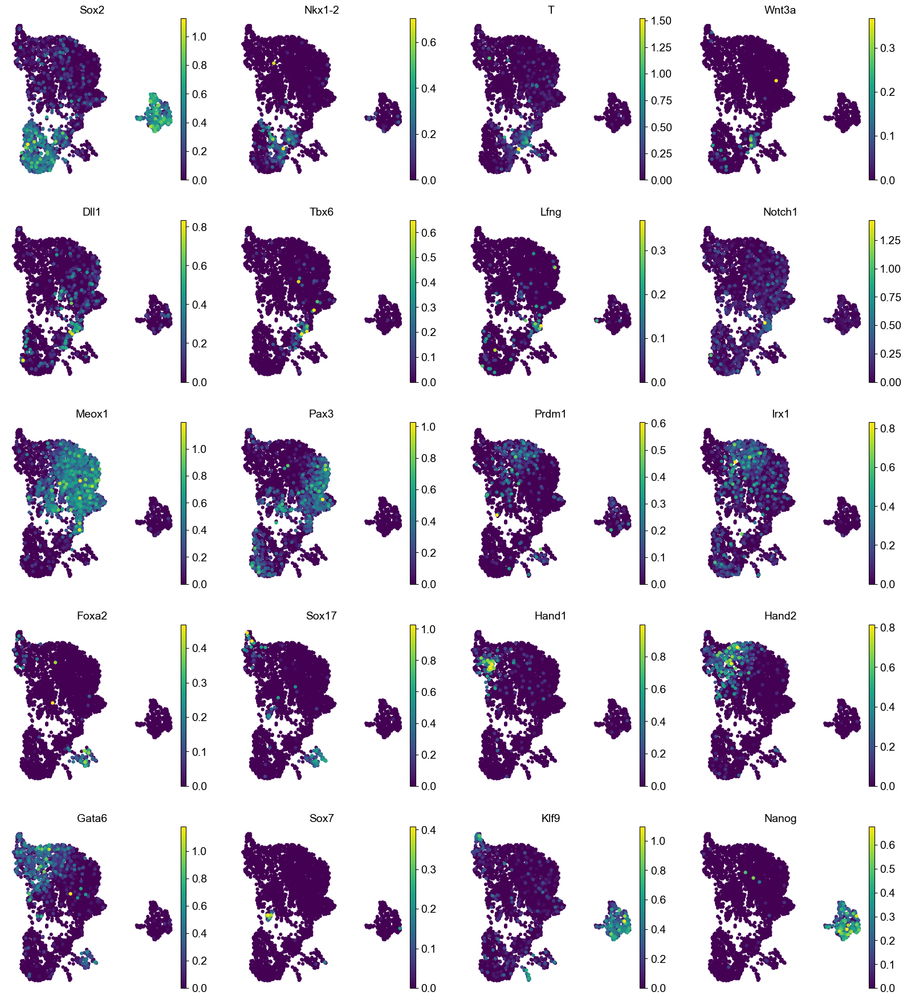

In [88]:
sc.set_figure_params(dpi=dpi, color_map = 'viridis')

genes = [
 #   'Elavl3','Sox21', #neurecto/neural tube
    'Sox2','Nkx1-2', #neural
    'T','Wnt3a', #tailbud
    'Dll1','Tbx6', #presomitic
    'Lfng','Notch1', #wavefront
    'Meox1','Pax3', #somitic
    'Prdm1','Irx1', #endo
    'Foxa2','Sox17',
    'Hand1','Hand2','Gata6', #heart
    'Sox7', #haeomgenic
    'Klf9', #allantois
    'Nanog'  #PGCs
]

sc.pl.umap(adata, color=genes, use_raw = True, size = 80, frameon = False, ncols = 4)

In [15]:
counts = collections.defaultdict(dict)
for gastruloid in adata.obs['Gastruloid'].unique():
    counts[gastruloid]['total'] = adata.obs['Gastruloid'].str.count(gastruloid).sum()
    for celltype in adata.obs['celltype'].unique():
        counts[gastruloid][celltype] =  adata.obs[adata.obs['celltype'] == celltype]['Gastruloid'].str.count(gastruloid).sum()

In [16]:
counts2 = collections.defaultdict(dict)
for gastruloid in adata.obs['Gastruloid'].unique():
    counts2[gastruloid] = [('total', adata.obs['Gastruloid'].str.count(gastruloid).sum())]
    for celltype in adata.obs['celltype'].unique():
        counts2[gastruloid] =  [(celltype, adata.obs[adata.obs['celltype'] == celltype]['Gastruloid'].str.count(gastruloid).sum())]

In [17]:
pd.DataFrame(counts2)

,B11,B08,A08,C01
0,"(Early Somitic, 52)","(Early Somitic, 326)","(Early Somitic, 223)","(Early Somitic, 206)"


In [18]:
gastruloid_counts = pd.DataFrame(counts).T

In [19]:
def reformat(celltype):
    x = pd.DataFrame(gastruloid_counts[celltype]).reset_index()
    x['measurement'] = celltype
    x = x.rename(columns = {celltype:'counts'})
    return(x)



a = reformat('total')
b = reformat('(Early) Endoderm')
c = reformat('Neurons')
d = reformat('Mesoderm')
e = reformat('Somitogenesis Wavefront/Presomitic')
f = reformat('Allantois')
g = reformat('Tailbud')
h = reformat('PGCs')
i = reformat('Haemogenic')
j = reformat('Endoderm')
k = reformat('Heart Progenitors')
l = reformat('Early Somitic')
z = pd.concat([b,c,d,e,f,g,h,i,j,k,l])


In [24]:
gastruloid_counts = gastruloid_counts.reset_index().rename(columns={'index':'gastruloid'})
gastruloid_counts

,gastruloid,total,Heart Progenitors,Mesoderm,Neurons,Endoderm,Haemogenic,Allantois,(Early) Endoderm,PGCs,Tailbud,Somitogenesis Wavefront/Presomitic,Early Somitic
0,B11,932,99,259,341,22,17,7,76,42,11,6,52
1,B08,921,114,57,30,11,9,2,227,57,54,34,326
2,A08,927,124,85,145,30,9,8,214,53,25,11,223
3,C01,856,116,75,45,29,2,4,151,150,52,26,206


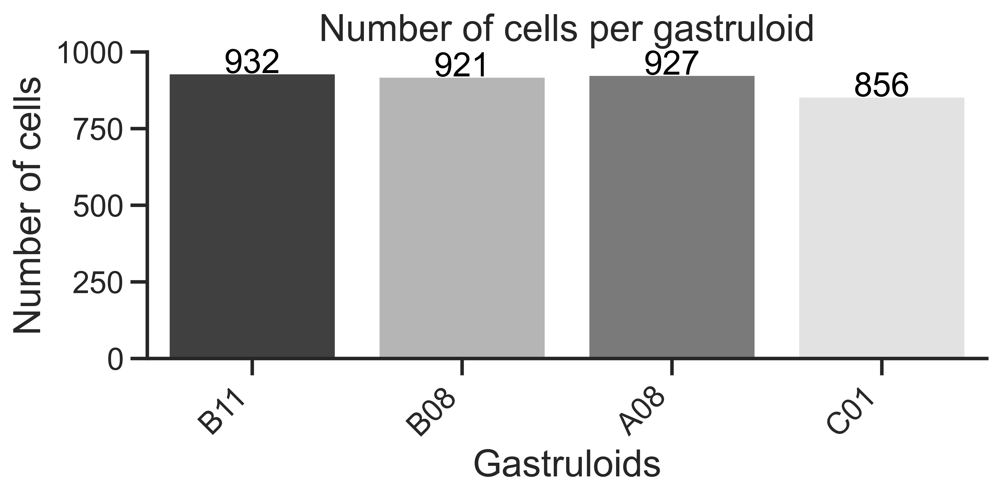

In [31]:
fig,ax = plt.subplots(figsize=(8,3))
fontsize = 20
sns.set_style('white')
sns.set_context("talk")
sns.set_style('ticks')

pal = sns.color_palette("Greys_r", len(gastruloid_counts))
rank = gastruloid_counts["total"].argsort().argsort() 

ax = sns.barplot(x='gastruloid',y='total',data=gastruloid_counts.reset_index()#, color='black')
                 ,palette=np.array(pal[::-1])[rank])



for index, row in gastruloid_counts.iterrows():
    ax.text(row.name, row.total, round(row.total,2), color='black', ha="center", va = 'baseline')

ax.tick_params(axis = 'x',rotation=45)
plt.setp(ax.xaxis.get_majorticklabels(), ha='right')
ax.set_xlabel("Gastruloids",fontsize=fontsize)
ax.set_title('Number of cells per gastruloid', fontsize=fontsize)
ax.set_ylabel("Number of cells",fontsize=fontsize)

ax.set_ylim(0,1000)

sns.despine()

plt.show()




In [27]:
new = gastruloid_counts.set_index('gastruloid').T
new['Total'] = new.sum(axis=1)
new

gastruloid,B11,B08,A08,C01,Total
total,932,921,927,856,3636
Heart Progenitors,99,114,124,116,453
Mesoderm,259,57,85,75,476
Neurons,341,30,145,45,561
Endoderm,22,11,30,29,92
Haemogenic,17,9,9,2,37
Allantois,7,2,8,4,21
(Early) Endoderm,76,227,214,151,668
PGCs,42,57,53,150,302
Tailbud,11,54,25,52,142


In [267]:
percentages = new.T[new.loc['total'] > 150].T

for gastruloid in percentages:
    percentages[gastruloid] = percentages[gastruloid]/percentages[gastruloid]['total']*100


In [276]:
order = ['(Early) Endoderm','Neurons','Mesoderm','Somitogenesis Wavefront/Presomitic','Endoderm',
        'Allantois','Tailbud','PGCs','Haemogenic','Heart Progenitors','Early Somitic']

percentages = percentages.reindex(order)

In [277]:
percentages.loc['(Early) Endoderm':][['B11','B08','A08','C01']]

gastruloid,B11,B08,A08,C01
(Early) Endoderm,8.154506,24.647123,23.085221,17.640187
Neurons,36.587983,3.257329,15.641855,5.257009
Mesoderm,27.789700,6.188925,9.169364,8.761682
Somitogenesis Wavefront/Presomitic,0.643777,3.691640,1.186624,3.037383
Endoderm,2.360515,1.194354,3.236246,3.387850
Allantois,0.751073,0.217155,0.862999,0.467290
Tailbud,1.180258,5.863192,2.696872,6.074766
PGCs,4.506438,6.188925,5.717368,17.523364
Haemogenic,1.824034,0.977199,0.970874,0.233645
Heart Progenitors,10.622318,12.377850,13.376483,13.551402


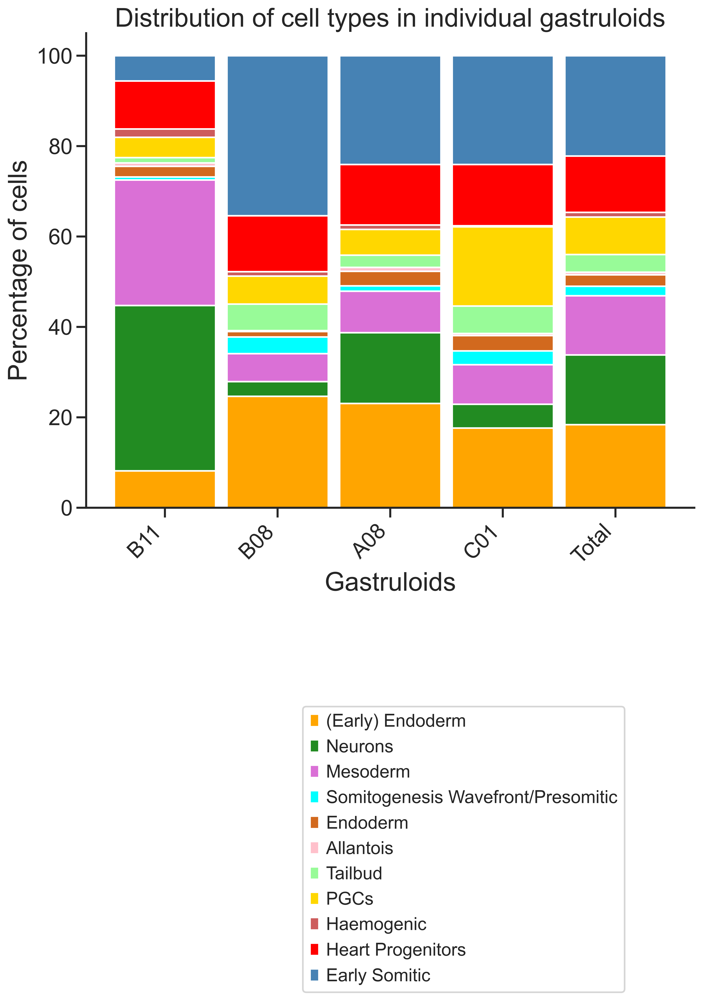

In [284]:
cols= ['orange','forestgreen','orchid','cyan','chocolate','pink','palegreen','gold','indianred',
      'red','steelblue']

fig,ax = plt.subplots(figsize=(4,6), dpi = 300)
#sns.set_context("talk")
sns.set_style('ticks')
#mpl.rcParams['pdf.fonttype'] = 42
#mpl.rcParams['ps.fonttype'] = 42
#mpl.rcParams['font.family'] = 'Arial'
fontsize = 24
ax = percentages.loc['(Early) Endoderm':].T.plot.bar(stacked=True,figsize=(10,8),fontsize = 20,width=0.90, 
                                                     color=cols, ax = ax)
ax.set_xlabel("Gastruloids",fontsize=fontsize)
ax.set_title('Distribution of cell types in individual gastruloids', fontsize=fontsize)
ax.set_ylabel("Percentage of cells",fontsize=fontsize)
ax.tick_params(axis='x', rotation=45)
plt.setp(ax.xaxis.get_majorticklabels(), ha='right')
#ax.set_xticklabels("")
sns.despine()
ax.legend(bbox_to_anchor=(0.9,-0.4))
#ax.legend([],frameon=False)

In [10]:
adata = sc.read(results_file)